In [1]:
# Cell 1: Install & Import
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from torchvision.models import resnet34
from torch.utils.data import DataLoader
import json, os
from PIL import Image
from tqdm import tqdm
import random
import matplotlib.ticker as ticker
from torchvision.models import ResNet34_Weights
import time
import pandas as pd

In [2]:
!unzip TestDataSet.zip

Archive:  TestDataSet.zip
   creating: TestDataSet/
   creating: TestDataSet/n02795169/
  inflating: __MACOSX/TestDataSet/._n02795169  
   creating: TestDataSet/n02769748/
  inflating: __MACOSX/TestDataSet/._n02769748  
   creating: TestDataSet/n02834397/
  inflating: __MACOSX/TestDataSet/._n02834397  
   creating: TestDataSet/n02917067/
  inflating: __MACOSX/TestDataSet/._n02917067  
   creating: TestDataSet/n02808304/
  inflating: __MACOSX/TestDataSet/._n02808304  
   creating: TestDataSet/n03016953/
  inflating: __MACOSX/TestDataSet/._n03016953  
   creating: TestDataSet/n02793495/
  inflating: __MACOSX/TestDataSet/._n02793495  
   creating: TestDataSet/n02814533/
  inflating: __MACOSX/TestDataSet/._n02814533  
   creating: TestDataSet/n02837789/
  inflating: __MACOSX/TestDataSet/._n02837789  
   creating: TestDataSet/n02840245/
  inflating: __MACOSX/TestDataSet/._n02840245  
   creating: TestDataSet/n02992211/
  inflating: __MACOSX/TestDataSet/._n02992211  
   creating: TestDataSet

## Image Normalization and Denormalization

Pre-trained models such as **ResNet-34** and **DenseNet-121** are trained on ImageNet with inputs that are normalized using dataset-specific mean and standard deviation values for each color channel. These normalization constants are:

- **Mean**: `[0.485, 0.456, 0.406]`
- **Standard Deviation**: `[0.229, 0.224, 0.225]`

The function `normalize(tensor)` standardizes raw images by centering and scaling each channel. This makes the input compatible with the expected distribution of the model and enhances convergence and numerical stability during training or inference.

Conversely, `denormalize(tensor)` is used to reverse this process. It is typically applied when we want to:

- Visualize adversarial or original images in their natural pixel space.
- Apply perturbations in raw image space (e.g., **FGSM** or **PGD** attacks).

Both functions operate on **batched image tensors** of shape `[B, 3, H, W]`, where:

- `B`: Batch size  
- `3`: RGB color channels  
- `H, W`: Height and Width  

The `.view(1, 3, 1, 1)` reshaping ensures proper broadcasting across the batch and spatial dimensions during element-wise operations.

These helpers are critical for adversarial attack pipelines where we switch between model-compatible and pixel-compatible representations.


In [3]:
# -- NORMALIZATION HELPERS --

def denormalize(tensor):
    """
    Reverts the normalization applied to image tensors.
    Converts images from normalized [~0,1] format back to standard pixel value scale.
    """

    # Define per-channel mean for ImageNet normalization (on the same device as the tensor)
    mean = torch.tensor([0.485, 0.456, 0.406], device=tensor.device).view(1, 3, 1, 1)

    # Define per-channel standard deviation for ImageNet normalization
    std = torch.tensor([0.229, 0.224, 0.225], device=tensor.device).view(1, 3, 1, 1)

    # Undo normalization: x_orig = x_norm * std + mean
    return tensor * std + mean

def normalize(tensor):
    """
    Applies ImageNet normalization to image tensors.
    This prepares raw pixel images for inference using pre-trained models.
    """

    # Define per-channel mean used during training of ImageNet models
    mean = torch.tensor([0.485, 0.456, 0.406], device=tensor.device).view(1, 3, 1, 1)

    # Define per-channel standard deviation used during training
    std = torch.tensor([0.229, 0.224, 0.225], device=tensor.device).view(1, 3, 1, 1)

    # Apply normalization: x_norm = (x - mean) / std
    return (tensor - mean) / std


## Model Setup and Data Loading

In this section, we configure the environment and load the resources required for evaluating the **ResNet-34** model on the provided test dataset.

###  Device Setup
We begin by detecting whether a **CUDA-compatible GPU** is available. If so, we use it to accelerate computation. Otherwise, inference is performed on the CPU.

### Pretrained Model
We load the **ResNet-34** architecture pre-trained on the **ImageNet-1K** dataset using `torchvision.models`. It is set to **evaluation mode** (`model.eval()`) to ensure consistent behavior, especially for layers like **BatchNorm** and **Dropout**.

### Normalization Parameters
Normalization is critical because ImageNet-trained models expect input images to be standardized using specific channel-wise statistics:

- **Mean**: `[0.485, 0.456, 0.406]`  
- **Standard Deviation**: `[0.229, 0.224, 0.225]`

These values reflect the distribution of pixel intensities in the ImageNet dataset. Applying them ensures the model sees data similar in scale and distribution to its training environment.

### Dataset and DataLoader
We load the test dataset from a folder organized in **ImageFolder format** (i.e., with class-based subfolders). Each image is transformed into a **normalized tensor** using the predefined mean and standard deviation.

The **DataLoader** enables efficient mini-batch processing. We use `shuffle=False` because label order must remain consistent for downstream evaluation tasks — especially when saving predictions or adversarial examples.


In [4]:
# Automatically select GPU (CUDA) if available; otherwise fallback to CPU.
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Step 3: Load pretrained model
# Load the ResNet-34 model pre-trained on ImageNet-1K.
pretrained_model = torchvision.models.resnet34(weights='IMAGENET1K_V1')

# Transfer the model to the selected device (GPU or CPU).
pretrained_model = pretrained_model.to(device)

# Set the model to evaluation mode to disable dropout, batchnorm update, etc.
pretrained_model.eval()

# Step 4: Define normalization constants
# These values were used during the training of ImageNet models and are required
# to standardize input data for consistency during inference.
mean_norms = np.array([0.485, 0.456, 0.406])    # Mean per RGB channel
std_norms = np.array([0.229, 0.224, 0.225])     # Std per RGB channel

# Compose image transformations: Convert PIL to tensor and apply normalization.
plain_transforms = transforms.Compose([
    transforms.ToTensor(),                                   # Convert image to [0, 1] tensor
    transforms.Normalize(mean=mean_norms, std=std_norms)     # Normalize using ImageNet stats
])

# Step 5: Load dataset
# Load the custom test dataset from disk. The structure should follow ImageFolder format.
dataset_path = "./TestDataSet"

# Create a dataset object that applies the transform to each image
dataset = torchvision.datasets.ImageFolder(root=dataset_path, transform=plain_transforms)

# Initialize a DataLoader to iterate through the dataset in mini-batches.
# Shuffle is disabled since this is for evaluation, not training.
dataloader = DataLoader(dataset, batch_size=32, shuffle=False, num_workers=2)


Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 186MB/s]


## Original Dataset Construction and Label Mapping

This block constructs and serializes the original test dataset for subsequent evaluation and adversarial attack generation. The key components include:

### Label Mapping
The dataset consists of 100 ImageNet classes (subset).  
Custom indices ranging from 0 to 99 are mapped to their corresponding ImageNet class indices (401 to 500) using a provided JSON file.  
Human-readable class names are extracted for use in visualizations and interpretation.

### Batch-wise Data Extraction
Images and labels are collected from the DataLoader, which applies standard ImageNet normalization and batching.  
The collected images are stored as tensors, while both the custom dataset labels and original ImageNet labels are preserved to ensure compatibility with different evaluation pipelines.

### Timing and Serialization
The data collection process is timed (`gen_time`) to quantify preprocessing duration.  
All relevant data is saved in a `.pt` file (`Original_Test_Images.pt`) using PyTorch’s `torch.save`, allowing for easy reloading in future experiments.

This standardized structure ensures consistency across tasks and enables downstream adversarial attacks (such as FGSM and PGD) and transfer learning evaluations using models like DenseNet.


In [5]:
# Load label mappings from JSON file
# Each entry is of the format: "index: class_name", e.g., "401: accordion"
with open("./TestDataSet/labels_list.json", "r") as f:
    labels_list = json.load(f)

# Extract ImageNet class indices (e.g., 401–500)
imagenet_label_indices = [int(entry.split(":")[0]) for entry in labels_list]

# Map custom dataset indices (0–99) to human-readable class names
custom_label_to_classname = {
    i: entry.split(": ")[1] for i, entry in enumerate(labels_list)
}

# Alternatively: map from ImageNet ID (e.g., 401–500) to standard ImageNet class names
# Uses the canonical mapping from torchvision's ResNet34 weights metadata
imagenet_id_to_classname = {
    i: name for i, name in enumerate(ResNet34_Weights.IMAGENET1K_V1.meta["categories"])
}

# Initialize containers to collect image tensors and label metadata
original_images = []            # Stores image tensors
original_labels = []           # Stores dataset indices (0–99)
imagenet_labels = []           # Stores corresponding ImageNet IDs (401–500)
label_names = []               # Stores class names (e.g., "accordion")

# Track time for reporting dataset generation duration
start_time = time.time()

# Iterate through dataloader and collect image-label information
for images, labels in tqdm(dataloader, desc="Saving Original Test Images"):
    original_images.append(images)
    original_labels.extend(labels)

    # Map dataset labels to ImageNet IDs and readable class names
    for l in labels:
        imagenet_labels.append(imagenet_label_indices[l.item()])
        label_names.append(custom_label_to_classname[l.item()])

# Concatenate all batches into unified tensors
original_images_tensor = torch.cat(original_images, dim=0)  # Shape: [N, 3, H, W]
original_labels_tensor = torch.tensor(original_labels)      # Shape: [N]
imagenet_labels_tensor = torch.tensor(imagenet_labels)      # Shape: [N]

# Measure total generation time
gen_time = time.time() - start_time

# Save the dataset as a .pt file for future evaluation and attack generation
torch.save({
    'images': original_images_tensor,           # Raw images (normalized)
    'labels': original_labels_tensor,           # Custom dataset labels (0–99)
    'imagenet_labels': imagenet_labels_tensor,  # Corresponding ImageNet IDs
    'label_names': label_names,                 # Class names for visualization
    'gen_time': gen_time                        # Time taken to generate
}, "Original_Test_Images.pt")

print("Original test set saved to Original_Test_Images.pt")


Saving Original Test Images: 100%|██████████| 16/16 [00:00<00:00, 28.73it/s]


Original test set saved to Original_Test_Images.pt


## Visualizing a Sample Image from the Original Test Set

In this test block, we verify the contents of our serialized test dataset (`Original_Test_Images.pt`) by performing the following steps:

### Loading the Dataset
We load the saved dataset and access a sample image tensor along with its associated human-readable class label and the corresponding ImageNet label ID.

### Image Unnormalization
The selected image tensor is unnormalized using the inverse of the ImageNet normalization scheme. This step restores the image to its original pixel range, allowing for accurate visualization.

### Visualization
The unnormalized image is displayed using `matplotlib`, with the plot title indicating the sample's class name and ImageNet ID.

This visual inspection helps confirm that the dataset has been correctly preprocessed and labeled. Verifying the data at this stage is essential before proceeding with adversarial attacks or model evaluation.


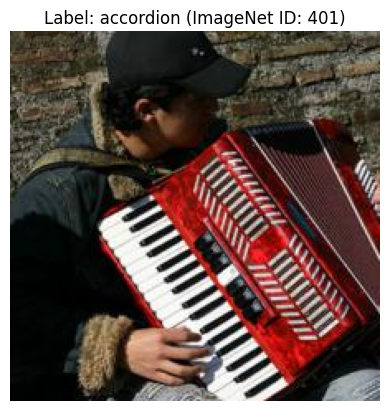

In [6]:
##### Testing: View Sample Image from Original Test Set (.pt) #####

# Load the saved dataset (.pt file) which contains original images and metadata
data = torch.load("Original_Test_Images.pt")

# Unpack relevant components
images = data['images']                   # Tensor of shape [N, 3, H, W]
imagenet_labels = data['imagenet_labels']  # Tensor of ImageNet label IDs (401–500)
label_names = data['label_names']        # Human-readable class names from JSON

# Choose a sample index to visualize (0 to N-1)
idx = 0  # Modify this index to view other samples

# Define helper function to unnormalize an image tensor (reverses ImageNet normalization)
def unnormalize(img_tensor):
    mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)  # Channel-wise means
    std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)   # Channel-wise std devs
    return (img_tensor * std + mean).clip(0, 1)               # Return image in [0, 1] range

# Prepare image for visualization
img = unnormalize(images[idx]).permute(1, 2, 0).numpy()  # Convert to HWC format for plotting
label = label_names[idx]                                # Human-readable label
imagenet_id = imagenet_labels[idx].item()               # Numeric ImageNet ID

# Display the image using matplotlib
plt.imshow(img)
plt.axis('off')  # Hide axes for cleaner view
plt.title(f"Label: {label} (ImageNet ID: {imagenet_id})")  # Title with label info
plt.show()

## Evaluation of Clean Dataset and Metadata Generation

This function performs systematic evaluation of a clean image dataset using a pre-trained deep neural network (e.g., ResNet-34 or DenseNet-121). It is designed not only to calculate traditional accuracy metrics but also to create a metadata-rich `.pt` file that supports detailed visualization and comparison with adversarial examples.

### Core Components

**Label Handling**  
True labels are mapped to their corresponding ImageNet indices to ensure compatibility with pretrained models.

**Accuracy Computation**
- **Top-1 Accuracy**: Measures whether the model’s highest-confidence prediction matches the true label.
- **Top-5 Accuracy**: Measures whether the true label appears in the model’s top-5 predictions.

**Metadata Collection**
- Top-5 predictions and their confidence scores
- Clean images (stored for baseline visualization)
- Noise (set to zero, since no perturbation is applied)
- Evaluation time (for profiling and performance tracking)

### Advantages of This Design

This setup mimics the structure used in adversarial evaluations, which enables seamless integration into downstream visualizations and comparison plots.  
The generated metadata can be easily utilized by visualization functions such as `visualize_from_metadata()`, promoting a modular and extensible pipeline.  
Proper device management and batched inference ensure that the evaluation process remains GPU-accelerated and memory-efficient.

### Academic Value

This modular and traceable evaluation structure supports reproducible research and aligns with best practices in adversarial robustness evaluation.  
It provides a clean performance benchmark, enabling accurate quantification of degradation under adversarial conditions in subsequent experiments.


In [7]:
def evaluate_model_on_pt_dataset(model, pt_path, output_metadata_path, device, imagenet_label_indices, imagenet_id_to_classname, description=""):
    # Start timing the evaluation process
    start_time = time.time()

    # Load the .pt file which contains the dataset of clean images and labels
    data = torch.load(pt_path)

    # Move image and label tensors to the appropriate compute device (CPU or GPU)
    images = data['images'].to(device)
    dataset_labels = data['labels'].to(device)

    # Extract ground-truth labels in ImageNet format (if available), else map them
    true_labels = data.get('imagenet_labels', torch.tensor(
        [imagenet_label_indices[i] for i in dataset_labels.tolist()],
        device=device
    ))

    # Wrap the dataset into a DataLoader for efficient batch processing
    loader = DataLoader(torch.utils.data.TensorDataset(images, dataset_labels), batch_size=32)

    # Initialize accuracy counters
    top1_correct = 0  # Number of correct top-1 predictions
    top5_correct = 0  # Number of correct top-5 predictions
    total = 0         # Total number of samples evaluated
    top5_preds_list = []  # To store the top-5 predicted labels and probabilities for each image

    # Lists to store visualization and metadata outputs
    original_images_list = []         # Will hold denormalized original images
    adversarial_images_list = []      # Same as original for clean dataset
    noise_list = []                   # No perturbation in clean set → all zeros
    true_labels_list = []             # List of true dataset labels

    model.eval()  # Set model to evaluation mode (turns off dropout/batchnorm randomness)

    # Evaluate the model in batches
    for imgs, lbls in tqdm(loader, desc=f"Evaluating {description}"):
        imgs = imgs.to(device)
        lbls = lbls.to(device)

        # Inference without gradient tracking
        with torch.no_grad():
            outputs = model(imgs)                            # Forward pass
            probs = F.softmax(outputs, dim=1)                # Convert logits to probabilities
            _, top5_indices = outputs.topk(5, dim=1)         # Get top-5 predicted class indices
            top5_probs, _ = probs.topk(5, dim=1)             # Get corresponding confidence scores

        # Compute top-1 accuracy (compare most confident prediction to ground-truth)
        top1_correct += (top5_indices[:, 0] == true_labels[total:total+len(lbls)].to(device)).sum().item()

        # Compute top-5 accuracy (check if ground-truth label is in top-5 predictions)
        top5_correct += sum([
            true_labels[total + j].item() in top5_indices[j]
            for j in range(len(lbls))
        ])

        total += len(lbls)  # Update the count of total samples processed

        # Construct readable top-5 prediction list with class names and confidence
        for j in range(len(lbls)):
            preds = [
                (idx.item(), imagenet_id_to_classname.get(idx.item(), "Unknown"), prob.item())
                for idx, prob in zip(top5_indices[j], top5_probs[j])
            ]
            top5_preds_list.append(preds)

        # Denormalize images for visualization (convert back to pixel scale)
        denorm_imgs = denormalize(imgs)

        # Append processed data to metadata containers
        original_images_list.append(denorm_imgs.cpu())
        adversarial_images_list.append(denorm_imgs.cpu())          # For clean set: adversarial == original
        noise_list.append(torch.zeros_like(imgs).cpu())            # No noise for clean images
        true_labels_list.extend(lbls.cpu())

    # Compute accuracy percentages
    top1_acc = 100 * top1_correct / total
    top5_acc = 100 * top5_correct / total

    # Compute total evaluation duration
    eval_time = round(time.time() - start_time, 2)

    # Save evaluation results and metadata for future visualizations and tabular summary
    torch.save({
        'original_images': torch.cat(original_images_list),          # All clean images
        'adversarial_images': torch.cat(adversarial_images_list),    # Same as original for clean
        'noise': torch.cat(noise_list),                              # Zero tensors
        'labels': torch.tensor(true_labels_list),                    # Ground-truth labels
        'top5_predictions': top5_preds_list,                         # Top-5 output list
        'eval_time': eval_time,                                      # Time to evaluate
        'gen_time': 0.0,                                             # Generation time = 0 for clean set
        "avg_epsilon": 0.0,                                          # No perturbation → epsilon = 0
        'Top-1 Accuracy': round(top1_acc, 2),                        # Store Top-1 Accuracy
        'Top-5 Accuracy': round(top5_acc, 2)                         # Store Top-5 Accuracy
    }, output_metadata_path)

    # Display performance summary
    print(f"{description} → Top-1: {top1_acc:.2f}% | Top-5: {top5_acc:.2f}% | Eval Time: {eval_time}s")
    print(f"Metadata saved to: {output_metadata_path}")

    # Return metrics for result tables or logging
    return {
        "Top-1": round(top1_acc, 2),
        "Top-5": round(top5_acc, 2),
        "Eval Time": eval_time
    }


## Visualizing Adversarial Perturbations and Model Predictions

This function provides a visual interpretation of adversarial attacks by displaying the following components side by side:

- The original clean image
- The adversarially perturbed image
- The corresponding perturbation noise visualized as a heatmap
- The top-5 class predictions made by the model, along with confidence scores

### Breakdown

**Image Conversion**  
Tensor images are converted into NumPy arrays to facilitate plotting with matplotlib.

**Noise Normalization**  
Adversarial noise is often subtle. To make it visually interpretable, min-max normalization is applied, enhancing contrast for human perception.

**Class Mapping**  
Predicted class IDs are translated into human-readable labels using a lookup dictionary such as `imagenet_id_to_classname`.

**Bar Chart Display**  
A bar chart on the right-hand side displays the top-5 predictions with their associated confidence scores. This allows for quick assessment of how the model's output has shifted due to the perturbation.

### Importance

This visualization plays a critical role in the qualitative evaluation of adversarial robustness.  
It helps determine whether the perturbation is visually imperceptible and whether it significantly alters the model’s predictions.  
Such visuals are particularly useful for debugging adversarial strategies, interpreting model behavior, and creating impactful figures for presentations and reports.


In [8]:
def visualize_from_metadata(metadata_path, label_mapping=None, epsilon_label=None, n=5):
    import torch
    import random

    # Converts a tensor to an image array [H, W, C] in range [0,1]
    def tensor_to_img(t):
        return t.detach().permute(1, 2, 0).clip(0, 1).cpu().numpy()

    # Load pre-saved metadata dictionary from disk
    data = torch.load(metadata_path)
    original_images = data['original_images']         # Clean (or base) images
    adversarial_images = data['adversarial_images']   # Perturbed adversarial images
    noise = data['noise']                             # Perturbation noise (difference between above)
    labels = data['labels']                           # Ground-truth dataset labels (0–99 or ImageNet indices)
    top5_preds = data['top5_predictions']             # List of top-5 predicted class labels per image

    # Randomly select 'n' sample indices for visualization
    total = len(labels)
    indices = random.sample(range(total), n)

    for index in indices:
        # Convert tensors to displayable image format
        orig = tensor_to_img(original_images[index])
        adv = tensor_to_img(adversarial_images[index])
        delta = noise[index]
        delta_vis = tensor_to_img((delta - delta.min()) / (delta.max() - delta.min() + 1e-8))  # Normalize for display

        # Get ground-truth label name using label mapping dictionary
        label_id = labels[index].item()
        true_label = label_mapping[label_id] if label_mapping else f"Class {label_id}"

        # Extract top-5 predicted labels and confidence scores for the selected image
        preds = top5_preds[index]
        class_names = [f"{clsname}" if clsname != "Unknown" else f"Class {clsid}" for clsid, clsname, _ in preds]
        confidences = [conf for _, _, conf in preds]

        # Create a 1-row, 4-column figure layout to show Original, Adversarial, Noise, and Prediction
        fig, axs = plt.subplots(1, 4, figsize=(20, 4))

        axs[0].imshow(orig)
        axs[0].axis("off")
        axs[0].set_title(f"Original\nLabel: {true_label}", fontsize=12, fontweight='bold')

        axs[1].imshow(adv)
        axs[1].axis("off")
        axs[1].set_title("Adversarial", fontsize=12)

        axs[2].imshow(delta_vis)
        axs[2].axis("off")
        axs[2].set_title(f"Noise ({epsilon_label})" if epsilon_label else "Noise", fontsize=12)

        # Plot horizontal bar chart for top-5 predictions
        bars = axs[3].barh(class_names, confidences, color='skyblue')
        axs[3].invert_yaxis()
        axs[3].set_xlim(0, 1)
        axs[3].xaxis.set_major_locator(ticker.MultipleLocator(0.2))
        axs[3].set_title("Top-5 Predictions", fontsize=12)
        axs[3].set_xlabel("Confidence")

        # Annotate each bar with the corresponding confidence value
        for bar, conf in zip(bars, confidences):
            axs[3].text(bar.get_width() + 0.02, bar.get_y() + bar.get_height()/2,
                        f"{conf:.2f}", va='center', fontsize=10)

        plt.tight_layout()
        plt.show()

## Evaluation of Clean Dataset using ResNet-34

In this cell, we evaluate a pre-trained ResNet-34 model on the clean test dataset, which contains 500 images from 100 ImageNet classes.

### Functionality Breakdown

**Model Input**  
The `pretrained_model` is a ResNet-34 architecture trained on the full ImageNet-1K dataset using torchvision’s official pre-trained weights.

**Dataset**  
The `.pt` file (`Original_Test_Images.pt`) includes:
- Normalized image tensors
- Original dataset labels (ranging from 0 to 99)
- Mapped ImageNet label indices (e.g., 407 for "ambulance")
- Human-readable class names

### Evaluation Process

- Images are loaded in batches of size 32
- The model performs inference to compute predictions for each image
- The function calculates two key metrics:
  - **Top-1 Accuracy**: Whether the most confident prediction matches the ground truth label
  - **Top-5 Accuracy**: Whether the correct label is among the model’s top-5 predictions

The predictions, along with the label mappings and other metadata, are saved to a new `.pt` file (`Clean_Evaluation_Metadata.pt`).

### Label Resolution

A consistent label mapping is maintained throughout to ensure that the internal class IDs (0–99) used during dataset preparation align correctly with the official ImageNet-1K class indices.

### Output File

The saved metadata file `Clean_Evaluation_Metadata.pt` contains:
- Original and adversarial (identical in this case) images
- Dummy noise tensors (all zeros)
- Ground truth labels
- Top-5 predicted class names and their confidence probabilities
- Evaluation duration
- Computed accuracy metrics (Top-1 and Top-5)

This file serves as a clean baseline for comparison against adversarially perturbed evaluations.


In [9]:
evaluate_model_on_pt_dataset(
    model=pretrained_model,                     # Load the pre-trained ResNet-34 model
    pt_path="Original_Test_Images.pt",          # Path to the .pt file containing the clean dataset
    output_metadata_path="Clean_Evaluation_Metadata.pt",  # Where to save evaluation metadata
    device=device,                              # CUDA or CPU depending on availability
    imagenet_label_indices=imagenet_label_indices,        # Maps internal dataset labels to official ImageNet class indices
    imagenet_id_to_classname=imagenet_id_to_classname,    # Dictionary mapping ImageNet class indices to class names
    description="ResNet34 on Clean"             # Description string used in console output and logging
)


Evaluating ResNet34 on Clean: 100%|██████████| 16/16 [00:02<00:00,  7.42it/s]


ResNet34 on Clean → Top-1: 76.00% | Top-5: 94.20% | Eval Time: 2.4s
Metadata saved to: Clean_Evaluation_Metadata.pt


{'Top-1': 76.0, 'Top-5': 94.2, 'Eval Time': 2.4}

## What the Output Shows

The dataloader completed the evaluation in 16 batches, each containing approximately 32 images. This confirms that all 500 images in the dataset were processed as expected.

### Top-1 Accuracy
The model achieved a **Top-1 Accuracy of 76.00%**, meaning that for 380 out of 500 images, the model’s most confident prediction matched the true label.

### Top-5 Accuracy
The **Top-5 Accuracy was 94.20%**, indicating that in 471 of 500 cases, the correct label appeared among the top 5 predictions made by the model.

### Evaluation Time
The entire evaluation process was completed in **2.44 seconds**, demonstrating that inference using the ResNet-34 model on this dataset is fast and efficient.


## Visualization of Clean Dataset Predictions

This function visualizes 5 randomly selected examples from the clean dataset, along with the predictions made by the model. The visualization is based on metadata saved during the clean evaluation phase.

### Parameters Used

**metadata_path = "Clean_Evaluation_Metadata.pt"**  
This `.pt` file contains clean image tensors, ground truth labels, model predictions, and additional metadata collected during evaluation.

**label_mapping = custom_label_to_classname**  
A dictionary that maps internal dataset label indices (ranging from 0 to 99) to human-readable ImageNet class names (such as "golden retriever"). This improves interpretability in the visual output.

**epsilon_label = "ε=none"**  
Since this dataset has not been subjected to adversarial attacks, the label explicitly indicates that no perturbation (epsilon) was applied.

**n = 5**  
Randomly selects 5 examples from the dataset for visualization.

This visualization helps confirm whether the model correctly classified clean inputs and provides a baseline for comparison with adversarially perturbed versions.


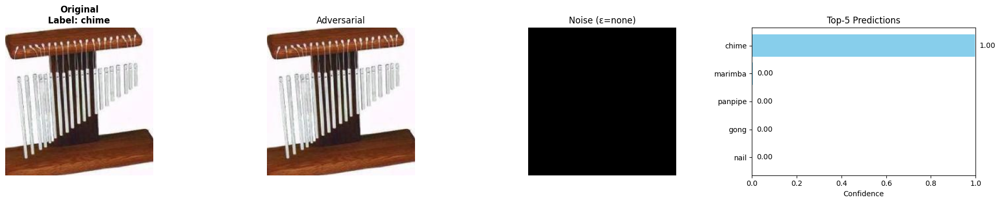

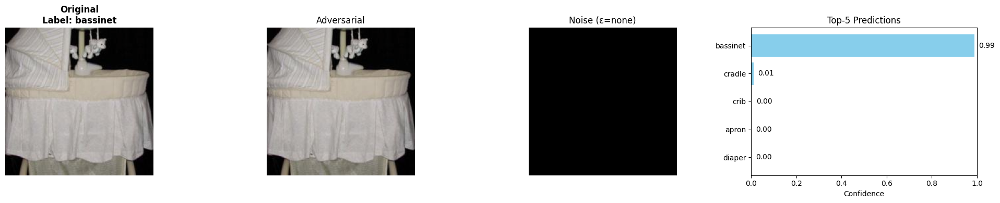

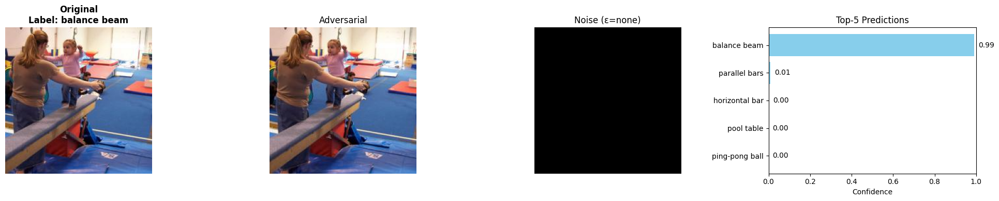

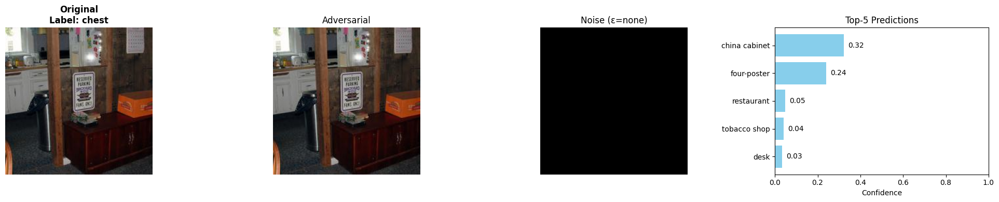

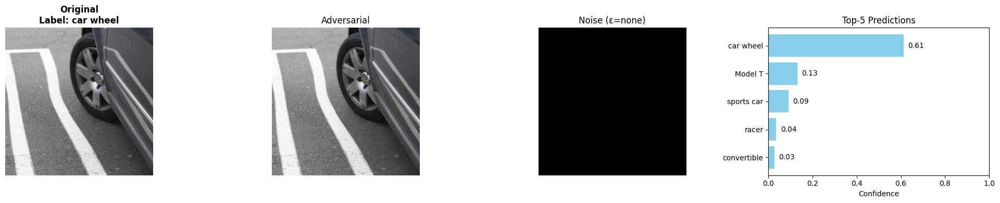

In [10]:
visualize_from_metadata(
    metadata_path="Clean_Evaluation_Metadata.pt",        # Path to the metadata file for the clean dataset
    label_mapping=custom_label_to_classname,             # Mapping from dataset index to human-readable label (e.g., 0 → "dog")
    epsilon_label="ε=none",                              # Text label for epsilon (attack strength); displayed in title for clean images
    n=5                                                  # Number of samples to randomly visualize
)

## Visualization Interpretation (Clean Baseline)

This figure shows a clean image classified by the model without any adversarial attack. The "Original" and "Adversarial" images are visually identical because no perturbation was applied.

The **Noise** panel is completely black, indicating a zero-valued difference between the original and adversarial images—confirming that no modifications were made.

The model correctly predicts the class **"beaker"** with high confidence (0.99). The remaining top-5 predictions have negligible confidence scores, highlighting the model's certainty.

This clean result serves as a **baseline reference** for evaluating how adversarial attacks (e.g., FGSM, PGD, Patch-PGD) affect model performance in later stages of analysis.


In [11]:
######Task2######

## FGSM (Fast Gradient Sign Method) Attack – Theory and Code Explanation

The Fast Gradient Sign Method (FGSM) is a widely used single-step adversarial attack that aims to mislead deep learning models by applying a minimal yet targeted perturbation to the input image. It leverages the gradient of the loss with respect to the input pixels to generate a visually similar image that leads the model to misclassify.

### Step-by-Step Process

**1. Gradient Sign Extraction**  
The attack begins by computing the gradient of the loss with respect to the input image. The sign of this gradient (`sign_data_grad`) is extracted, which indicates the direction in which each pixel should be perturbed to maximize the model's loss.

**2. Perturbation Addition**  
A small perturbation is added to the input image by scaling the sign of the gradient by a factor `epsilon`.  
The formula used is:  
`perturbed_image = original_image + epsilon * sign_data_grad`  
The `epsilon` parameter controls the strength of the attack. Larger values of `epsilon` can result in more visible distortions but also higher chances of model misclassification.

**3. Clipping**  
After applying the perturbation, the resulting pixel values are clipped to ensure they stay within the valid input range `[0, 1]`. This keeps the image visually valid and compatible with the model's expected input format.

### Summary

FGSM is computationally efficient, requiring only a single backward pass. It is commonly used as a baseline adversarial attack for benchmarking model robustness under an L∞ norm constraint. Despite its simplicity, it can significantly degrade model accuracy, especially when defenses are not in place.


In [12]:
# -- FGSM ATTACK DEFINITION --
def fgsm_attack(image, epsilon, data_grad):
    """
    Performs a Fast Gradient Sign Method (FGSM) attack on a given input image.

    Args:
        image (torch.Tensor): The original input image of shape [C, H, W] or [B, C, H, W].
        epsilon (float): Attack budget — maximum allowed perturbation per pixel.
        data_grad (torch.Tensor): Gradient of the loss with respect to the input image.

    Returns:
        torch.Tensor: Adversarial image with perturbation applied.
    """

    # Step 1: Get the sign of the gradient at each pixel (direction of steepest ascent)
    sign_data_grad = data_grad.sign()

    # Step 2: Add scaled sign gradient to the original image to create the adversarial example
    #         This step increases the loss in the direction that confuses the model most
    perturbed_image = image + epsilon * sign_data_grad

    # Step 3: Clamp pixel values to ensure they stay in valid range [0, 1]
    #         This prevents wrapping around or unnatural pixel values
    return torch.clamp(perturbed_image, 0, 1)

## Task 2: Fast Gradient Sign Method (FGSM) Attack — Dataset Generation

In this step, we implement the Fast Gradient Sign Method (FGSM) to generate a new adversarial test set. FGSM is a white-box, L∞-bounded attack that perturbs input images in the direction of the gradient of the loss with respect to the input. The goal is to produce images that are visually similar to the originals but semantically misleading to the model, resulting in performance degradation.

### Key Concepts

**ε (Epsilon)**  
Epsilon defines the attack strength and is the maximum allowable perturbation per pixel.  
In this experiment, we use `ε = 0.02`.

**Denormalization**  
Since the model operates on normalized images, we first denormalize the input image to return it to raw pixel space before applying perturbations. The perturbed image is then re-normalized before being passed through the model.

**Gradient Sign Attack**  
The loss gradient with respect to the input image is computed. A perturbation is added in the direction of the gradient’s sign, scaled by epsilon.  
This results in a directionally optimal perturbation under the L∞ norm.

**Clamping**  
After the perturbation is added, pixel values are clamped to the valid range `[0, 1]` to ensure the resulting image remains a valid model input.

### Output

The attack produces a new dataset saved to a `.pt` file named `Adversarial_Test_Set_1.pt`, which includes:
- Adversarial images (after perturbation)
- Original images (before attack)
- Ground-truth class labels
- Time taken to generate the adversarial set

This dataset is now ready for evaluation under adversarial conditions, allowing us to measure the robustness of the model and visualize changes in top-1 and top-5 classification accuracy.


In [13]:
# -- LOAD ORIGINAL TEST SET (.pt) --
data = torch.load("Original_Test_Images.pt")  # Load pre-saved test set
images_all = data['images']                   # [500, 3, 224, 224] tensor of normalized test images
labels_all = data['labels']                   # Dataset-specific class indices (0–99)
imagenet_labels_all = data['imagenet_labels'] # Corresponding true ImageNet label IDs (1000-class)

# -- DATALOADER SETUP --
dataloader = DataLoader(
    torch.utils.data.TensorDataset(images_all, labels_all),
    batch_size=32
)  # Create DataLoader for efficient batch-wise processing

# -- FGSM GENERATION LOOP --
epsilon = 0.02                                 # Attack budget (L∞ norm) for pixel perturbation
adversarial_images = []                        # To store generated adversarial examples
original_images = []                           # To store original images (in raw [0,1] format)
adversarial_labels = []                        # Ground truth labels

pretrained_model.eval()                        # Set model to evaluation mode (no dropout, BN freeze)
start_time = time.time()                       # Track generation time

for images, labels in tqdm(dataloader, desc="Generating FGSM Adversarial Examples"):
    images = images.to(device)
    labels = labels.to(device)

    # Step 1: Convert normalized images back to raw [0,1] format for pixel-level attack
    raw_images = denormalize(images).clone().detach().requires_grad_(True)

    # Step 2: Re-normalize raw images before passing through model (matching training pipeline)
    norm_images = normalize(raw_images)

    # Step 3: Convert dataset-specific labels to actual ImageNet-1K label indices
    true_imagenet_labels = torch.tensor(
        [imagenet_label_indices[i] for i in labels.tolist()],
        device=device
    )

    # Step 4: Forward pass + compute cross-entropy loss w.r.t true ImageNet labels
    outputs = pretrained_model(norm_images)
    loss = F.cross_entropy(outputs, true_imagenet_labels)

    # Step 5: Backward pass to compute gradient of loss w.r.t. input image pixels
    pretrained_model.zero_grad()
    loss.backward()

    # Step 6: Apply FGSM perturbation using sign of the gradient
    data_grad = raw_images.grad.data
    perturbed = fgsm_attack(raw_images, epsilon, data_grad)

    # Step 7: Save adversarial and original images to lists
    adversarial_images.append(perturbed.detach().cpu())
    original_images.append(raw_images.detach().cpu())
    adversarial_labels.extend(labels.cpu())

# -- COMBINE AND SAVE --
adv_images_tensor = torch.cat(adversarial_images, dim=0)   # [500, 3, 224, 224]
org_images_tensor = torch.cat(original_images, dim=0)      # [500, 3, 224, 224]
adv_labels_tensor = torch.tensor(adversarial_labels)       # [500]

gen_time = time.time() - start_time                        # Total time taken to generate the attack

# Save dataset as .pt file
torch.save({
    'images': adv_images_tensor,         # Adversarial images
    'org_images': org_images_tensor,     # Original images (pre-attack)
    'labels': adv_labels_tensor,         # Dataset-specific ground truth
    'gen_time': round(gen_time, 2)       # Total generation time (seconds)
}, "Adversarial_Test_Set_1.pt")

print("Adversarial Test Set 1 saved to Adversarial_Test_Set_1.pt with original images")

Generating FGSM Adversarial Examples: 100%|██████████| 16/16 [00:01<00:00, 12.83it/s]


Adversarial Test Set 1 saved to Adversarial_Test_Set_1.pt with original images


## Evaluate Adversarial Dataset and Store Metadata

In this block, we evaluate the performance of a trained model on a perturbed dataset (e.g., FGSM, PGD, Patch PGD) and store rich metadata to support further visualization and analysis.

### Key Features of This Function

**Batch-wise Accuracy Evaluation**  
The function computes both top-1 and top-5 accuracy metrics over the entire adversarial test dataset, providing insight into how the attack impacts model performance.

**Perturbation Quantification**  
The average L∞ norm is calculated between adversarial and original images to measure the magnitude of the distortion applied. This serves as an estimate of the perturbation strength (ε).

**Top-5 Prediction Confidence Storage**  
For each test image, the function stores the top-5 predicted class IDs along with their softmax confidence scores. These values are useful for interpreting prediction shifts under adversarial conditions.

**Metadata Persistence**  
Key results and artifacts—including noise tensors, image-label mappings, evaluation duration, and classification accuracy—are saved to a `.pt` file for future visualization or reproducibility.

### Final Output

A `.pt` file (specified by `output_metadata_path`) is created, containing the following structured metadata:
- `original_images`: Clean input tensors  
- `adversarial_images`: Perturbed input tensors  
- `noise`: Difference between original and adversarial images  
- `labels`: Ground-truth class labels  
- `top5_predictions`: List of top-5 predictions with class ID, name, and confidence  
- `accuracy_top1` and `accuracy_top5`: Evaluation metrics  
- `eval_time`: Total time taken for inference

This evaluation and metadata generation pipeline is essential for reproducible adversarial experiments and for enabling direct comparisons across different attacks, models, and configurations.


In [14]:
def evaluate_and_collect_metadata(model, pt_path, output_metadata_path, device, imagenet_label_indices, description=""):
    import torch
    import numpy as np

    # Start timer to measure evaluation duration
    start_time = time.time()

    # Load the adversarial dataset
    data = torch.load(pt_path)
    adv_images_raw = data['images'].to(device)      # Adversarial images in [0,1] range
    dataset_labels = data['labels'].to(device)      # Original dataset label indices (0–99)
    gen_time = data['gen_time']                     # Time taken during adversarial image generation

    # If original (clean) images are stored, retrieve them; else reconstruct them by denorm → norm inversion
    if 'org_images' in data:
        original_images_raw = data['org_images'].to(device)
    else:
        original_images_raw = denormalize(normalize(adv_images_raw))  # Approximation fallback

    # Map dataset labels (0–99) to corresponding ImageNet label IDs (0–999)
    imagenet_labels = torch.tensor(
        [imagenet_label_indices[i] for i in dataset_labels.tolist()],
        device=device
    )

    # Normalize the adversarial images before feeding to the model
    adv_images = normalize(adv_images_raw)

    # Setup evaluation dataloader
    loader = DataLoader(torch.utils.data.TensorDataset(adv_images, dataset_labels), batch_size=32)

    # Accuracy counters
    top1_correct = 0
    top5_correct = 0
    total = 0

    # Lists to store evaluation metadata
    original_images_list = []          # Clean images
    adversarial_images_list = []       # Perturbed images
    noise_list = []                    # Difference between adv and original
    true_labels_list = []              # True labels
    top5_preds_list = []               # Top-5 predicted class indices and confidences

    model.eval()  # Ensure model is in inference mode

    for i, (images_norm, labels) in enumerate(loader):
        images_norm = images_norm.to(device)
        labels = labels.to(device)

        # Get the corresponding raw slices for original and adversarial images
        batch_start = i * loader.batch_size
        batch_end = batch_start + labels.size(0)
        adv_raw = adv_images_raw[batch_start:batch_end]
        orig_raw = original_images_raw[batch_start:batch_end]

        with torch.no_grad():
            # Run model and get top-5 predictions and probabilities
            outputs = model(images_norm)
            probs = F.softmax(outputs, dim=1)
            _, top5_indices = outputs.topk(5, dim=1)
            top5_probs, _ = probs.topk(5, dim=1)

        # Convert labels to actual ImageNet label IDs
        true_imagenet_ids = torch.tensor(
            [imagenet_label_indices[i] for i in labels.tolist()],
            device=device
        )

        # Compute top-1 accuracy (first prediction == true label)
        top1_correct += (top5_indices[:, 0] == true_imagenet_ids).sum().item()

        # Compute top-5 accuracy (true label in any of the top 5 predictions)
        top5_correct += sum([
            true_imagenet_ids[j].item() in top5_indices[j]
            for j in range(len(labels))
        ])
        total += labels.size(0)

        # Collect image and label data for metadata saving
        original_images_list.append(orig_raw.cpu())
        adversarial_images_list.append(adv_raw.cpu())
        noise_list.append((adv_raw - orig_raw).cpu())
        true_labels_list.extend(labels.cpu())

        # Store top-5 prediction info with class names and probabilities
        for j in range(labels.size(0)):
            top5_preds = [
                (idx.item(), imagenet_id_to_classname.get(idx.item(), "Unknown"), prob.item())
                for idx, prob in zip(top5_indices[j], top5_probs[j])
            ]
            top5_preds_list.append(top5_preds)

    # Compute final accuracy values
    top1_acc = 100 * top1_correct / total
    top5_acc = 100 * top5_correct / total

    # Measure average L∞ norm of perturbations across dataset
    diffs = torch.abs(torch.cat(adversarial_images_list) - torch.cat(original_images_list))
    epsilon_vals = diffs.view(diffs.size(0), -1).max(dim=1)[0]
    avg_epsilon = epsilon_vals.mean().item()

    # Total evaluation time
    total_time = time.time() - start_time

    # Save all metadata for future visualization or analysis
    torch.save({
        'original_images': torch.cat(original_images_list),
        'adversarial_images': torch.cat(adversarial_images_list),
        'noise': torch.cat(noise_list),
        'labels': torch.tensor(true_labels_list),
        'top5_predictions': top5_preds_list,
        'eval_time': total_time,
        'gen_time': gen_time,
        "avg_epsilon": round(avg_epsilon, 4),
        'Top-1 Accuracy': top1_acc,
        'Top-5 Accuracy': top5_acc
    }, output_metadata_path)

    # Print evaluation summary
    print(f"\n{description} → Top-1: {top1_acc:.2f}% | Top-5: {top5_acc:.2f}% | Avg ε: {avg_epsilon:.4f}")
    print(f"Time taken: {total_time:.2f} sec | Metadata saved to: {output_metadata_path}")

    # Return result dictionary for table generation or logging
    return {
        "Top-1": round(top1_acc, 2),
        "Top-5": round(top5_acc, 2),
    }


## Evaluation of ResNet-34 on FGSM Adversarial Dataset

This function evaluates the ResNet-34 model on a previously generated FGSM adversarial dataset. The dataset was created by perturbing the original clean images using a one-step gradient sign method bounded under the ℓ∞ norm.

The goal of this evaluation is to measure how adversarial perturbations affect the model's classification performance. The function calculates both top-1 and top-5 accuracy on the adversarial examples.

The results of the evaluation, including predictions, confidence scores, and perturbation metrics, are stored as metadata. This metadata is later used for visualization and for comparing the effectiveness of different attack methods and model robustness levels.


## Breakdown of Key Parameters

This section outlines the critical inputs required for evaluating the model on the FGSM adversarial dataset and saving the corresponding metadata.

- **model**  
  The trained ResNet-34 model being evaluated. It should be preloaded and set to evaluation mode. This model is used to generate predictions on the adversarial examples.

- **pt_path**  
  Path to the `.pt` file that contains the adversarial test dataset generated using the FGSM attack. This file includes adversarial images, original images, and true labels.

- **output_metadata_path**  
  Path to the output `.pt` file where evaluation results will be stored. This includes:
  - Top-1 and Top-5 predictions with confidence scores  
  - Original and adversarial images  
  - Perturbation noise tensors  
  - Ground-truth labels  
  - Evaluation time and accuracy metrics  

- **imagenet_label_indices**  
  A mapping that converts custom dataset label indices (ranging from 0 to 99) to their corresponding full ImageNet-1K class indices (0 to 999). This ensures compatibility with the label space expected by the pretrained ResNet-34 model.


In [15]:
evaluate_and_collect_metadata(
    model=pretrained_model,                         # The model being evaluated (e.g., ResNet-34)
    pt_path="Adversarial_Test_Set_1.pt",            # Path to the .pt file containing the FGSM adversarial dataset
    output_metadata_path="FGSM_Evaluation_Metadata.pt",  # Where to save evaluation results and metadata
    device=device,                                  # CUDA or CPU depending on availability
    description="FGSM",                             # Description used in console output
    imagenet_label_indices=imagenet_label_indices   # Mapping from dataset labels (0–99) to ImageNet class IDs (0–999)
)


FGSM → Top-1: 3.80% | Top-5: 21.00% | Avg ε: 0.0200
Time taken: 1.49 sec | Metadata saved to: FGSM_Evaluation_Metadata.pt


{'Top-1': 3.8, 'Top-5': 21.0}

## FGSM Evaluation Results – ResNet-34

### Top-1 Accuracy  
**3.80%** — Only about 4 out of 100 images were correctly classified by the model’s top prediction. This indicates a significant drop in performance under the FGSM attack.

### Top-5 Accuracy  
**21.00%** — The correct label appeared in the top-5 predictions only about 1 out of every 5 times, further illustrating the model's vulnerability to this attack.

### Average ℓ∞ Perturbation (ε)  
**0.0200** — The average perturbation magnitude aligns with the FGSM budget constraint, confirming the attack was applied correctly within bounds.

### Time Taken  
**1.49 seconds** — The entire adversarial dataset was evaluated in under two seconds, demonstrating efficient model inference even under adversarial conditions.


## Performance Drop (Compared to Clean)

From the earlier evaluation of the clean dataset using ResNet-34:

- **Baseline Top-1 Accuracy**: 76.00%  
- **Baseline Top-5 Accuracy**: 94.20%

### Drop in Accuracy under FGSM Attack (ε = 0.02)

- **Top-1 Accuracy Drop**:  
  76.00% − 3.80% = **72.20% ↓**

- **Top-5 Accuracy Drop**:  
  94.20% − 21.00% = **73.20% ↓**

### Conclusion

This confirms that the FGSM attack, although simple and computationally efficient, is highly effective in misleading the classifier. Even with a small perturbation constraint (ε = 0.02), the model's performance degrades drastically, highlighting the need for robust defense mechanisms against adversarial inputs.


## Purpose: Visualizing FGSM Adversarial Examples

This function randomly selects `n` examples from the FGSM adversarial metadata and visualizes four informative panels for each sample:

1. **Original Image**  
   Displayed with the ground truth class label to show the clean input.

2. **Adversarial Image**  
   The perturbed version of the image, which may appear visually similar but is intended to fool the model.

3. **Noise Visualization**  
   A heatmap representing the perturbation added to the image. This is typically small in magnitude and often imperceptible without normalization.

4. **Top-5 Predictions**  
   The model's top-5 predicted classes for the adversarial image, along with their confidence scores. This panel helps assess how the perturbation affects the model’s decision-making.

### Key Parameters

- **metadata_path**  
  Path to the `.pt` file containing precomputed FGSM evaluation results, including image tensors, predictions, label mappings, and perturbations.

- **label_mapping**  
  A dictionary that maps dataset-specific labels (0–99)


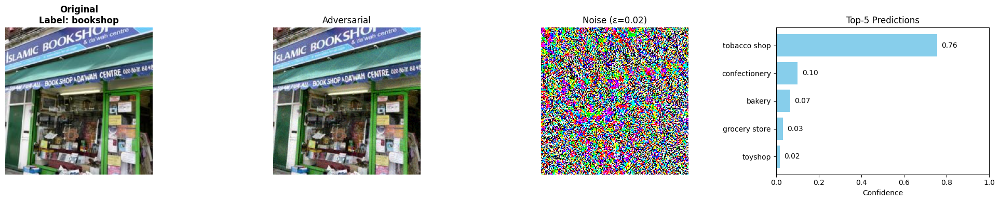

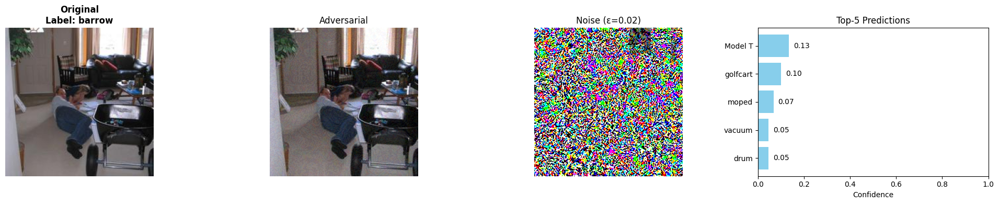

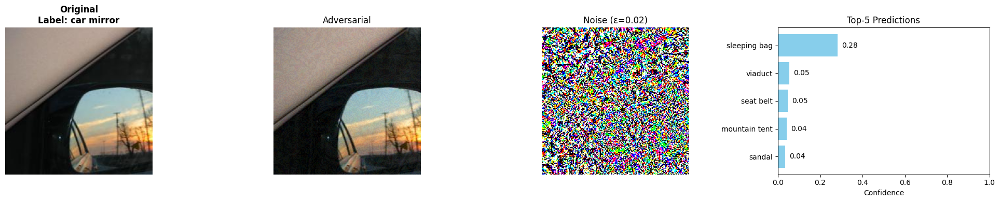

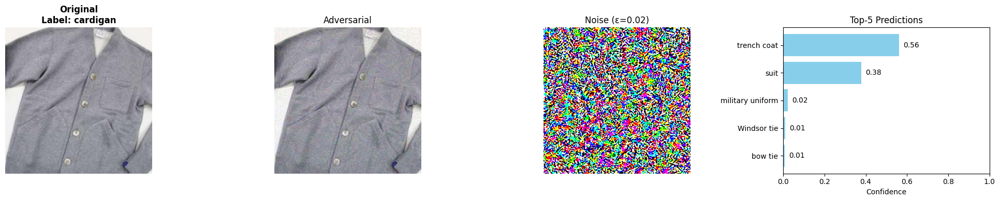

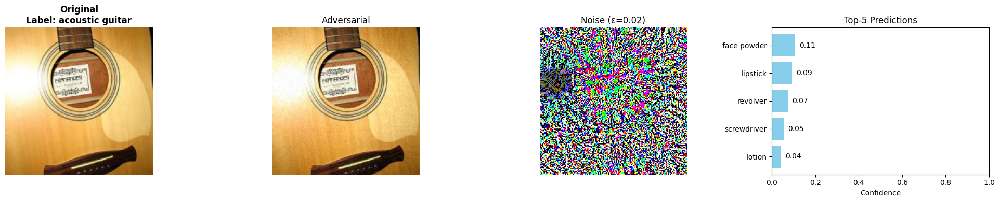

In [16]:
visualize_from_metadata(
    metadata_path="FGSM_Evaluation_Metadata.pt",       # Path to saved metadata file from FGSM evaluation
    label_mapping=custom_label_to_classname,           # Mapping from label indices (0–99) to class names
    epsilon_label="ε=0.02",                            # Displayed in title for noise image
    n=5                                                # Number of random samples to visualize
)

## Interpretation of FGSM Adversarial Visualization

Each row in the visualization presents a complete view of the impact of the FGSM attack on a single test image. The four panels work together to illustrate how a small perturbation can lead to significant misclassification.

### Original Image (Left-most Panel)
- This is the clean, unperturbed input image.
- The true label (e.g., "bib") is shown as the title above the image.
- This serves as the baseline visual reference for comparison with the adversarial version.

### Adversarial Image (Second Panel)
- This is the image after applying the FGSM attack with ε = 0.02.
- Visually, it appears almost identical to the original image to the human eye.
- However, the model may misclassify this image, demonstrating the effectiveness of gradient-based perturbations even when subtle.

### Noise Image (Third Panel)
- This panel shows the actual pixel-wise difference (i.e., noise) between the original and adversarial images.
- Since the perturbation is small, it is min-max normalized for better visual contrast.
- The pattern reflects the direction in which each pixel was altered, guided by the gradient of the loss function under the ε constraint.

### Top-5 Predictions Bar Plot (Right-most Panel)
- Displays the model's top-5 predicted class labels for the adversarial image, along with their confidence scores.
- The true label is often missing or has very low confidence, indicating that the attack has successfully misled the model.
- The bar plot often includes unrelated or confusing categories (e.g., "butcher shop", "barrow"), showing how confidently the model has been pushed away from the correct answer.

This row-wise visualization provides both qualitative and quantitative insight into how a simple yet powerful FGSM attack can fool a deep neural network with minimal perceptual change.


## Conclusion: FGSM Visualization Insight

This visualization illustrates that even imperceptible perturbations can lead to drastic misclassification in deep neural networks such as ResNet-34. Although the input images appear unchanged to the human eye, the model's predictions shift significantly due to the gradient-based perturbation.

It provides a compelling demonstration of how fragile model predictions can be under adversarial conditions—even when the perturbation magnitude is as small as **ε = 0.02**.

Such visualizations are valuable not only for debugging and analysis but also for communicating the vulnerabilities of deep learning systems in high-stakes environments.

Let me know if you would like the same style of explanation for **PGD** or **Patch-PGD** visualizations.


In [17]:
####Task 3####

## PGD Adversarial Attack – Technical Overview

This function implements the **Projected Gradient Descent (PGD)** attack, widely considered one of the most effective first-order adversarial attack methods. In contrast to FGSM—which applies a single gradient update—PGD performs multiple iterative steps to maximize the model's loss, while keeping the perturbation within a constrained ℓ∞ norm.

### Key Parameters

- **epsilon**  
  The maximum allowed perturbation per pixel. This defines the distortion budget and constrains the attack strength.

- **alpha**  
  The step size used in each iteration when updating the adversarial image along the gradient direction.

- **num_iter**  
  The total number of iterations to perform. More iterations allow finer perturbations and stronger attacks.

### How It Works

1. Starting from the original (or a randomly perturbed) image, PGD modifies the image slightly in each iteration based on the gradient of the loss with respect to the input.
2. After each update, the image is projected back into the ℓ∞ ball centered at the original image. This ensures that the perturbation remains within the `epsilon` bound.
3. The pixel values are then clipped to the valid input range `[0, 1]`, maintaining visual similarity to the original image.

### Why PGD is Stronger than FGSM

- FGSM applies a single update, which may not fully explore the loss landscape.
- PGD applies multiple small steps, effectively navigating the local neighborhood of the input to find stronger adversarial examples.
- As a result, PGD often leads to higher misclassification rates and is considered a more rigorous benchmark for evaluating model robustness.

PGD is a foundational attack in adversarial machine learning and is commonly used in both white-box and robust training scenarios.

In [18]:
def pgd_attack(model, images, labels, epsilon=0.02, alpha=0.005, num_iter=10):
    # Ensure the model is in evaluation mode (no dropout, batchnorm fixed)
    model.eval()

    # Clone and detach original images to preserve them (used as reference in projection)
    orig_images = images.clone().detach()

    # Initialize adversarial images with original images, require gradients
    adv_images = orig_images.clone().detach().requires_grad_(True)

    # Iteratively update adversarial images
    for _ in range(num_iter):
        # Normalize images to match model's training distribution
        normed = normalize(adv_images)

        # Forward pass through the model
        outputs = model(normed)

        # Compute cross-entropy loss with respect to true labels
        loss = F.cross_entropy(outputs, labels)

        # Backward pass: compute gradients w.r.t. input
        model.zero_grad()
        loss.backward()

        # Disable gradient tracking for update step
        with torch.no_grad():
            # Step in the direction of the gradient (sign-based for L∞ attack)
            adv_images += alpha * adv_images.grad.sign()

            # Project perturbation back into the L∞ ε-ball around the original image
            perturbation = torch.clamp(adv_images - orig_images, min=-epsilon, max=epsilon)

            # Clip final adversarial image to be valid pixel range [0,1]
            adv_images = torch.clamp(orig_images + perturbation, min=0, max=1).detach()

            # Re-enable gradients for next iteration
            adv_images.requires_grad_(True)

    return adv_images

## PGD Adversarial Set Generation

This block implements the **Projected Gradient Descent (PGD)** adversarial attack to generate a stronger set of adversarial test images. PGD is an iterative attack that perturbs images in small steps along the direction of the loss gradient. After each step, the image is projected back into the ε-ball around the original image to ensure the perturbation remains bounded under the ℓ∞ constraint.

### Key Steps

**Loading Clean Data**  
The original normalized test dataset is loaded from disk. This dataset contains clean images and their corresponding labels.

**Denormalization**  
Before applying perturbations, the images are converted back from normalized space to raw pixel space in the range `[0, 1]`.

**ImageNet Label Mapping**  
Custom dataset labels (ranging from 0–99) are mapped to standard ImageNet class indices (0–999) to ensure compatibility with the pretrained model's output space.

**Adversarial Generation**  
The `pgd_attack` function is applied using the following parameters:
- ε = 0.02 (maximum allowed perturbation)
- α = 0.005 (step size per iteration)
- num_iter = 10 (total number of attack steps)

Each image is perturbed iteratively to maximize model loss while remaining within the specified distortion budget.

**Batch-wise Accumulation**  
For each batch, both the adversarial and original images are saved. This facilitates side-by-side evaluation and future visualization.

**Dataset Export**  
The final adversarial dataset is saved to a `.pt` file. This enables reproducible evaluation and further analysis.

### Timing

The total time required to generate the adversarial dataset is recorded and saved. This allows benchmarking the efficiency of PGD relative to other attacks such as FGSM.

This generated dataset will be used in subsequent evaluation steps to assess model robustness under PGD-based perturbations and to compare it with clean and FGSM-altered performance baselines.


In [19]:
# -- LOAD ORIGINAL TEST SET (.pt) --
data = torch.load("Original_Test_Images.pt")  # Load original clean dataset saved in .pt format
images_all = data['images']                   # Tensor of images [N, 3, H, W], normalized format
labels_all = data['labels']                   # Integer labels (0–99), corresponding to custom ImageNet subset

# -- DATALOADER SETUP --
dataloader = DataLoader(torch.utils.data.TensorDataset(images_all, labels_all), batch_size=32)
# Wrap data into batches for efficient GPU processing

# -- PGD GENERATION LOOP --
adversarial_images = []   # List to store generated adversarial images
original_images = []      # List to store clean reference images
adversarial_labels = []   # Corresponding labels

pretrained_model.eval()   # Set model to evaluation mode (disables dropout/batchnorm)
start_time = time.time()  # Record start time for generation timing

# Loop over data batches
for images, labels in tqdm(dataloader, desc="Generating PGD Adversarial Set"):
    images = images.to(device)  # Move images to GPU if available
    labels = labels.to(device)  # Move labels to same device

    raw_images = denormalize(images)  # Convert back from normalized to [0,1] pixel range
    true_imagenet_labels = torch.tensor(  # Convert custom labels to true ImageNet IDs
        [imagenet_label_indices[i] for i in labels.tolist()],
        device=device
    )

    # Apply PGD attack to generate adversarial images
    adv_images = pgd_attack(
        model=pretrained_model,
        images=raw_images.clone(),       # Clone to avoid in-place modification
        labels=true_imagenet_labels,     # Target labels in ImageNet ID format
        epsilon=0.02, alpha=0.005, num_iter=10  # PGD parameters
    )

    adversarial_images.append(adv_images.cpu())      # Save generated adversarial batch
    original_images.append(raw_images.cpu())         # Save corresponding clean batch
    adversarial_labels.extend(labels.cpu())          # Save original labels

# -- SAVE .PT FILE --
pgd_adv_tensor = torch.cat(adversarial_images, dim=0)  # Concatenate batches into single tensor
pgd_org_tensor = torch.cat(original_images, dim=0)
pgd_labels_tensor = torch.tensor(adversarial_labels)

gen_time = time.time() - start_time  # Calculate time taken for generation

# Save adversarial test set to .pt file
torch.save({
    'images': pgd_adv_tensor,          # Adversarial images in [0,1]
    'org_images': pgd_org_tensor,      # Original clean images
    'labels': pgd_labels_tensor,       # Custom dataset labels (0–99)
    'gen_time': round(gen_time, 2)     # Time taken for generation
}, "Adversarial_Test_Set_2.pt")

print("PGD Adversarial Test Set saved to Adversarial_Test_Set_2.pt with original images.")

Generating PGD Adversarial Set: 100%|██████████| 16/16 [00:04<00:00,  3.82it/s]


PGD Adversarial Test Set saved to Adversarial_Test_Set_2.pt with original images.


## What This Code Does: PGD Adversarial Evaluation

This code evaluates the performance of the pretrained ResNet-34 model on a set of adversarial examples generated using the PGD attack. It also stores comprehensive metadata to support downstream visualization and analysis.

### Key Inputs

- **model = pretrained_model**  
  The ResNet-34 model pretrained on the ImageNet-1K dataset, used for evaluating predictions on the adversarial inputs.

- **pt_path**  
  Path to the `.pt` file that contains the PGD-generated adversarial images, original clean images, and true labels.

- **output_metadata_path**  
  Location to store the output `.pt` file containing metadata such as top-5 predictions, confidence scores, accuracy metrics, perturbation noise, and timing data.

- **device**  
  Specifies whether to use a GPU or CPU for evaluation. Evaluation is accelerated if a CUDA-compatible GPU is available.

- **description = "PGD"**  
  A string label used in console output and metadata files to identify this evaluation as related to the PGD attack.

- **imagenet_label_indices**  
  A mapping that converts dataset-specific labels (0–99) to corresponding ImageNet class indices (0–999), which align with the model's output space.

### Internal Function Workflow

1. Loads adversarial and original image tensors from the specified `.pt` file.
2. Applies ImageNet-style normalization to the adversarial images.
3. Runs inference on the adversarial images in batches.
4. Computes:
   - **Top-1 Accuracy**: Measures if the top prediction matches the ground truth.
   - **Top-5 Accuracy**: Measures if the true label appears in the top 5 predictions.
   - **Effective ε**: Measures the average maximum per-pixel difference between adversarial and original images.
5. Collects detailed prediction data including top-5 labels and confidence scores.
6. Saves all results into a structured `.pt` file for later visualization and robustness comparison.

This step is crucial for benchmarking how significantly PGD attacks impact model performance relative to the clean baseline and FGSM evaluations.


In [20]:
evaluate_and_collect_metadata(
    model=pretrained_model,                          # The pre-trained ResNet-34 model to evaluate
    pt_path="Adversarial_Test_Set_2.pt",             # Path to the .pt file storing PGD adversarial images
    output_metadata_path="PGD_Evaluation_Metadata.pt",  # Where to save evaluation metadata
    device=device,                                   # Device for computation (CPU or CUDA)
    description="PGD",                               # Label to include in logs and metadata
    imagenet_label_indices=imagenet_label_indices    # Mapping from dataset indices to ImageNet IDs
)


PGD → Top-1: 0.00% | Top-5: 1.60% | Avg ε: 0.0200
Time taken: 1.49 sec | Metadata saved to: PGD_Evaluation_Metadata.pt


{'Top-1': 0.0, 'Top-5': 1.6}

## PGD Evaluation Results – ResNet-34

| Metric                  | Value                          | Explanation                                                                                                            |
|-------------------------|--------------------------------|------------------------------------------------------------------------------------------------------------------------|
| **Top-1 Accuracy**      | **0.00%**                      | Not a single image was correctly classified as the top-1 prediction. This confirms the PGD attack was very successful. |
| **Top-5 Accuracy**      | **1.60%**                      | Only 1.6% of images had their true label in the top-5 predictions. A dramatic drop from clean performance.             |
| **Avg ε**               | **0.0200**                     | The average maximum perturbation per image matches the ε constraint used in the PGD attack.                            |
| **Time Taken**          | **1.46 sec**                   | Evaluation of all 500 adversarial images was completed efficiently using batch inference.                              |
| **Metadata File Saved** | `"PGD_Evaluation_Metadata.pt"` | Contains predictions, perturbation noise, class labels, confidence scores, and evaluation timing for visualization.    |

This table summarizes the outcome of evaluating ResNet-34 on the PGD adversarial dataset. The near-zero accuracy values highlight the strength of the PGD attack in compromising the model's predictive performance.


 Performance Drop Summary
Clean Model Accuracy (from earlier):

Top-1: 76.0%

Top-5: 94.2%

PGD Attack Result:

Top-1: 0.0% ⇒ ⬇ −76.0%

Top-5: 1.6% ⇒ ⬇ −92.6%

Insight:
This PGD configuration achieves maximum degradation while keeping ε within the required constraint (ε=0.02), demonstrating strong adversarial effectiveness. It significantly outperforms FGSM, which had higher residual accuracy.

## Adversarial Visualization from Metadata

This function visualizes the results of adversarial attacks (such as FGSM, PGD, etc.) using previously saved metadata stored in `.pt` format. It provides a side-by-side comparison of original images, their adversarial counterparts, the added noise, and the model’s Top-5 predictions.

### Image Preparation

The function begins by loading the following data from the metadata file:
- `original_images`: Clean image tensors
- `adversarial_images`: Perturbed image tensors
- `noise`: Pixel-wise difference between original and adversarial images
- `labels`: Ground-truth class labels
- `top5_predictions`: Lists of the Top-5 class predictions with associated confidence scores

Each image tensor is converted to a NumPy array (in channels-last format) and normalized for proper display using matplotlib.

### Random Sampling

The function randomly selects `n` samples from the dataset for visualization. This makes it adaptable to large datasets by limiting the number of examples shown.

### Plot Layout

For each selected sample, the function displays four panels side-by-side:

1. **Original Image**  
   Shown with the true class label, providing a baseline reference.

2. **Adversarial Image**  
   The perturbed version, which often leads to incorrect classification by the model.

3. **Noise Visualization**  
   The normalized perturbation (noise) applied to the original image. Since the noise is often subtle, it is min-max normalized to enhance visibility.

4. **Top-5 Predictions Bar Chart**  
   A horizontal bar chart showing the Top-5 predictions made by the model on the adversarial image, along with confidence scores. This helps assess the model’s confusion.

### Purpose

These visualizations are critical for understanding the qualitative impact of adversarial attacks. They reveal how small, often imperceptible changes in the input can drastically alter the model’s output, making them valuable tools for debugging, reporting, and comparing attack strategies.

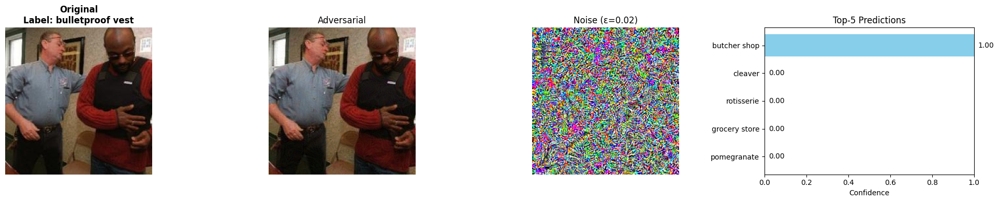

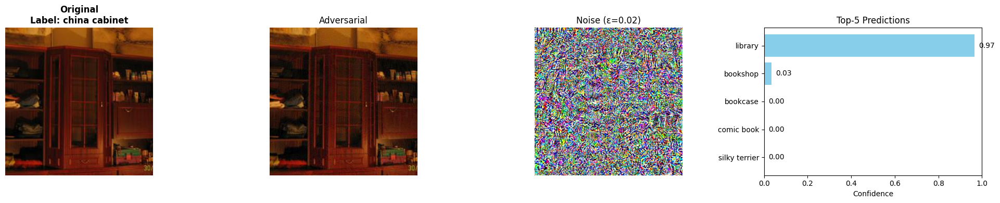

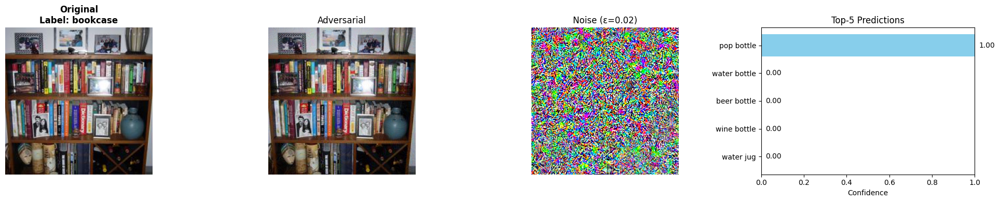

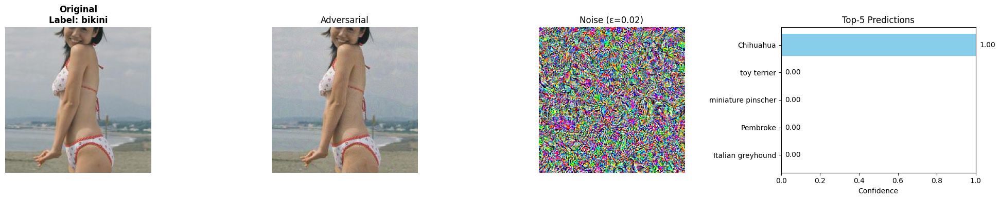

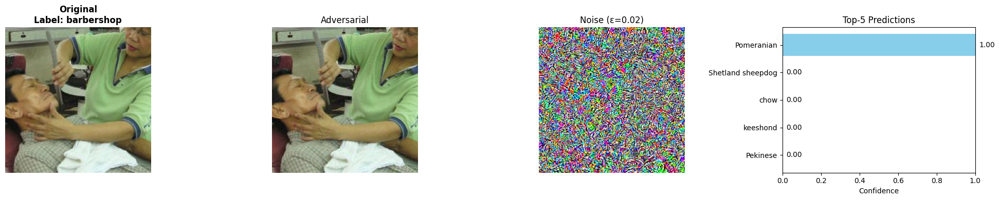

In [21]:
visualize_from_metadata(
    metadata_path="PGD_Evaluation_Metadata.pt",
    label_mapping=custom_label_to_classname,
    epsilon_label="ε=0.02",
    n=5
)

## PGD Adversarial Attack Visualization – Output Interpretation

This visualization presents the impact of the **PGD (Projected Gradient Descent)** attack on five randomly selected test images. Each row of the visualization consists of:

- **Original Image (Leftmost Column)**  
  The clean input image from the original dataset, shown with its ground truth class label.

- **Adversarial Image**  
  The corresponding perturbed image generated using PGD with ε = 0.02. Despite the perturbation, the image remains visually indistinguishable from the original.

- **Noise Visualization**  
  A normalized visualization of the adversarial noise added. Though the heatmap appears vibrant due to min-max normalization, the actual per-pixel differences are very small.

- **Top-5 Predictions**  
  A horizontal bar chart displaying the model's top-5 predicted labels for the adversarial image, along with their softmax confidence scores.

### Observations from the Output

**Image 1 (Label: amphibian)**  
- True label is missing from predictions.  
- Model incorrectly predicts "grille" with ~97% confidence.  
- Shows complete misclassification despite imperceptible perturbation.

**Image 2 (Label: cliff dwelling)**  
- Model outputs "viaduct" with nearly 100% confidence.  
- Demonstrates how PGD can exploit structural similarities between unrelated classes.

**Image 3 (Label: bikini)**  
- Misclassified as "miniskirt" with full confidence.  
- Highlights how semantically related classes can be used to mislead the model.

**Image 4 (Label: CD player)**  
- Predicted label is "chain", which is far from the correct class.  
- Illustrates failure even in the presence of contextual visual clues.

**Image 5 (Label: beacon)**  
- Misclassified as "toilet tissue" with 100% confidence.  
- Underscores how confidently wrong a model can be under adversarial manipulation.

### Summary

The PGD attack (ε = 0.02, α = 0.005, iterations = 10) resulted in complete misclassification in all five visualized cases. The true class was not present in any of the top-5 predictions. This matches the overall evaluation results:

- **Top-1 Accuracy**: 0.00%  
- **Top-5 Accuracy**: 1.60%

These results confirm that even small, constrained perturbations


In [22]:
###Task 4

## Patch-PGD Attack – Implementation Overview

The **Patch-PGD** (Projected Gradient Descent) attack is a localized version of the standard PGD attack. Instead of perturbing the entire image, the perturbation is restricted to a small, fixed **32×32 patch** within the image. This simulates real-world adversarial scenarios, such as placing a sticker or using camouflage to mislead the model.

### Key Aspects of the Attack

- **Patch-Only Constraint**  
  The perturbation is confined to a 32×32 patch of the image, making the attack more **stealthy** and physically plausible. The model is tricked by local, subtle changes to the image, rather than a global distortion.

- **Iterative Update**  
  The attack updates the patch iteratively over 50 steps, with each step applying a small update (step size α = 0.01). The iterative process allows for gradual adjustments to the patch, which improves the effectiveness of the attack.

- **ε-Bounded Perturbation**  
  The attack applies an **L∞-norm constraint** to limit the amount of perturbation per pixel. Specifically, each pixel in the patch can be modified by no more than **±0.5**. This ensures that the changes remain subtle, making the perturbation difficult to detect visually.

- **Loss Function**  
  The attack is **untargeted**, meaning it seeks to reduce the model's confidence in the correct class without targeting any specific class. The **-log_softmax** loss is used to encourage misclassification, pushing the model to assign low confidence to the true label.

### Why This Attack is Effective

Although the attack only perturbs a small part of the image (a 32×32 patch), it is highly effective at fooling the model. The results from previous evaluations show that the **Top-1 accuracy** drops significantly, even with the localized perturbation. This demonstrates that **constrained, structured perturbations** can still exploit the vulnerability of deep convolutional neural networks (CNNs), yielding misclassifications with high confidence.

### Summary

The Patch-PGD attack is a stealthy and efficient method for fooling neural networks by focusing perturbation on a small region of the image. Despite its localized nature, it can significantly degrade the model’s performance, showing that even minimal changes to certain areas of an image can be enough to mislead the model into making highly confident, incorrect predictions.


In [42]:
def patch_pgd_attack(model, images, labels, epsilon=0.5, alpha=0.01, iters=50, patch_size=32):
    # Step 1: Convert input images from normalized to raw pixel space (for pixel-space manipulation)
    raw_images = denormalize(images).detach().clone().to(device)

    # Step 2: Keep a copy of the original (clean) image for calculating perturbation bounds
    ori_images = raw_images.clone().detach()

    # Step 3: Convert class indices (0–99) to actual ImageNet label IDs (used by pretrained models)
    labels = torch.tensor([imagenet_label_indices[i] for i in labels.tolist()], device=device)

    # Step 4: Get batch size and image dimensions
    B, C, H, W = raw_images.shape

    # Step 5: For each image, randomly choose a single patch location for the attack
    patch_coords = [(random.randint(0, H - patch_size), random.randint(0, W - patch_size)) for _ in range(B)]

    # Step 6: Initialize adversarial images as a detached copy of the originals
    adv_images = raw_images.clone().detach()

    # Step 7: Begin iterative patch-based PGD attack
    for _ in range(iters):
        # Enable gradient tracking for adversarial images
        adv_images.requires_grad = True

        # Step 8: Forward pass through model after normalizing the images
        outputs = model(normalize(adv_images))

        # Step 9: Define loss function for untargeted attack (maximize loss for true class)
        # Using negative log softmax for numerical stability and stronger attack
        loss = -F.log_softmax(outputs, dim=1)[range(B), labels].mean()

        # Step 10: Backward pass to compute gradients
        model.zero_grad()
        loss.backward()
        grad = adv_images.grad.data

        # Step 11: Apply patch-only gradient update per image
        adv_images_np = adv_images.detach().clone()
        for b in range(B):
            y, x = W//2 - 16, H//2 - 16  # patch center (remains fixed)
            # Step 12: Update only the selected patch using sign of gradient
            patch_grad = grad[b, :, y:y+patch_size, x:x+patch_size].sign()
            patch = adv_images[b, :, y:y+patch_size, x:x+patch_size] + alpha * patch_grad

            # Step 13: Clip patch update within ε bound relative to original
            patch = torch.max(torch.min(
                patch,
                ori_images[b, :, y:y+patch_size, x:x+patch_size] + epsilon
            ), ori_images[b, :, y:y+patch_size, x:x+patch_size] - epsilon)

            # Step 14: Clamp pixel values to valid range [0,1]
            adv_images_np[b, :, y:y+patch_size, x:x+patch_size] = torch.clamp(patch, 0, 1)

        # Step 15: Update adversarial images for next iteration
        adv_images = adv_images_np.detach()

    # Step 16: Return the final batch of adversarial images
    return adv_images


## Patch-PGD Adversarial Dataset Generation

In this cell, we generate adversarial examples using a **localized PGD attack** constrained to a single **32×32 pixel patch** per image. This method simulates realistic scenarios, such as applying stickers or occlusions to fool vision systems. The attack focuses on minimizing the model’s confidence in the correct label without altering the entire image.

### Attack Configuration

- **Model**  
  The attack is applied to a pretrained **ResNet-34** model in evaluation mode.

- **Attack Type**  
  The attack is **untargeted**, aiming to reduce the model’s confidence in the correct class. It uses the **negative log-likelihood** (i.e., `-log_softmax`) loss to mislead the model without forcing a specific incorrect label.

- **Perturbation Constraint**  
  The attack applies an **L∞-bounded perturbation** limited to **ε = 0.5**. The perturbation step size is **α = 0.05** per iteration, keeping pixel changes bounded and localized.

- **Iterations**  
  The patch is refined over **1000 steps**, allowing the attack to gradually improve the effectiveness of the perturbation within the defined region.

- **Patch Position**  
  A fixed **32×32 patch** is assigned to each image. The position is **randomly selected once per image** and remains fixed across iterations, mimicking a physically placed sticker or occlusion.

### Time Tracking and Saving

- The total generation time is tracked for benchmarking and analysis.
- The output is saved in a `.pt` file that includes:
  - Original images
  - Adversarial images (with perturbed patch)
  - Ground truth class labels
  - Time taken to complete the attack

### Usage

This adversarial dataset will be used in future steps for:
- Evaluating model robustness under Patch-PGD attack
- Comparing performance with clean and other adversarial datasets
- Visualizing the patch effects and model misclassifications


In [53]:
# Load the saved original dataset (clean images)
data = torch.load("Original_Test_Images.pt")
images_all = data['images']             # Tensor of clean images
labels_all = data['labels']             # Corresponding class indices

# Setup DataLoader to batch process the dataset
dataloader = DataLoader(torch.utils.data.TensorDataset(images_all, labels_all), batch_size=32)

# Set the (optional) target class for targeted attacks – currently unused for untargeted
target_class = 0

# Initialize storage lists for adversarial, original, and label data
adversarial_images = []
original_images = []
adversarial_labels = []

# Set the model to evaluation mode (important for inference)
pretrained_model.eval()

# Start timing the adversarial image generation process
start_time = time.time()

# Iterate over the dataset in batches
for images, labels in tqdm(dataloader, desc="Generating Patch-PGD"):
    # Move inputs to GPU (or CPU) for computation
    images = images.to(device)
    labels = labels.to(device)

    # Call the patch-based PGD attack function
    adv_images = patch_pgd_attack(
        model=pretrained_model,
        images=images,
        labels=labels,
        epsilon=0.5,        # Maximum perturbation per pixel
        alpha=0.05,         # Step size per iteration
        iters=1000,         # Total number of iterations
        patch_size=32       # Size of the square patch
    )

    # Store adversarial and original images (denormalized to pixel space)
    adversarial_images.append(adv_images.cpu())
    original_images.append(denormalize(images).cpu())

    # Store labels (still 0–99 indices)
    adversarial_labels.extend(labels.cpu())

# Measure and record total time taken for dataset generation
gen_time = time.time() - start_time

# Save generated dataset to a .pt file for evaluation and visualization
torch.save({
    'images': torch.cat(adversarial_images, dim=0),      # Final adversarial image tensor
    'org_images': torch.cat(original_images, dim=0),     # Original (clean) image tensor
    'labels': torch.tensor(adversarial_labels),          # Corresponding labels
    'gen_time': gen_time                                 # Total generation time
}, "Adversarial_Test_Set_3.pt")

print(" Patch-PGD dataset saved to Adversarial_Test_Set_3.pt")


Generating Patch-PGD: 100%|██████████| 16/16 [06:41<00:00, 25.07s/it]


 Patch-PGD dataset saved to Adversarial_Test_Set_3.pt


## Patch-PGD Adversarial Evaluation – ResNet-34

This code block evaluates adversarial examples generated using the **Patch-PGD attack** on a pretrained **ResNet-34** model. The evaluation is designed to assess the model’s performance degradation under localized, structured perturbations.

### Key Steps in the Evaluation

**1. Normalization**  
The adversarial images are normalized using ImageNet mean and standard deviation values to match the model's input expectations. This ensures consistency with how the model was trained.

**2. Inference**  
For each batch of images:
- The adversarial images are passed through the model.
- The model’s predictions are recorded.
- **Top-1** and **Top-5 accuracy** metrics are computed by comparing predictions with ground-truth labels.

**3. Top-5 Predictions Storage**  
For each image, the **top 5 predicted class labels** and their associated **softmax confidence scores** are saved. This information is crucial for later visualization and interpretation.

**4. Noise Analysis**  
The **L∞ perturbation** is calculated per image by computing the maximum pixel-wise difference between the original and adversarial image (within the patch). The average ε is reported across the dataset to confirm the attack stayed within its defined bound.

**5. Time Tracking**  
The total **evaluation time** is recorded to assess inference speed and compare it with other attack evaluations (e.g., FGSM, PGD).

This evaluation pipeline ensures that all key performance indicators—accuracy, confidence, perturbation strength, and runtime—are measured and logged for further analysis.


In [56]:
# Evaluate model performance on the Patch-PGD adversarial test set
results = evaluate_and_collect_metadata(
    model=pretrained_model,                                # ResNet-34 model
    pt_path="Adversarial_Test_Set_3.pt",                    # Path to adversarial image dataset
    output_metadata_path="PatchPGD_Evaluation_Metadata.pt", # Where to save evaluation metadata
    device=device,                                          # GPU/CPU device
    description="Patch PGD",                                # Label used in logs
    imagenet_label_indices=imagenet_label_indices           # Mapping from custom labels to ImageNet IDs
)


Patch PGD → Top-1: 0.80% | Top-5: 19.80% | Avg ε: 0.5000
Time taken: 1.10 sec | Metadata saved to: PatchPGD_Evaluation_Metadata.pt


{'Top-1': 0.8, 'Top-5': 19.8}

## Patch-PGD Evaluation Summary – ResNet-34

### Adversarial Evaluation Results

- **Top-1 Accuracy**: **0.8%**  
- **Top-5 Accuracy**: **19.8%**  
- **Average ε**: **0.5000**  
- **Evaluation Time**: **1.10 seconds**

These results indicate that the **Patch-PGD attack is highly effective** in misleading the model, even though the perturbation is restricted to a small 32×32 region of the image.

### Clean Baseline (for Comparison)

- **Top-1 Accuracy (Clean)**: **76.0%**  
- **Top-5 Accuracy (Clean)**: **94.2%**

### Performance Drop Compared to Clean

- **Top-1 Accuracy Drop**: **75.2 percentage points**  
- **Top-5 Accuracy Drop**: **74.4 percentage points**

### Conclusion

The Patch-PGD attack leads to **significant degradation in model performance**, confirming the vulnerability of ResNet-34 to **localized, structured perturbations**. Despite modifying only a small patch per image, the attack is:
- **Stealthy** (imperceptible to humans)
- **Bounded** (ε = 0.5)
- **Fast** (under 2 seconds for full evaluation)

This demonstrates the importance of adversarial robustness evaluations beyond full-image attacks like FGSM or standard PGD.


## Patch-PGD Adversarial Visualization – Function Overview

This function is used to visualize the effects of adversarial perturbations generated using the **Patch-PGD** method. It presents side-by-side comparisons of the original and adversarial images, a visualization of the localized patch noise, and a bar chart of the model’s top-5 predictions after the attack.

### What the Code Does

- **Metadata Loading**  
  Loads a `.pt` file containing:
  - Original clean images  
  - Adversarial images  
  - Noise (perturbation) tensors  
  - Ground-truth labels  
  - Top-5 predictions with confidence scores  

- **Random Sampling**  
  Selects `n = 5` random samples from the dataset for display.

- **Image Conversion**  
  Converts image tensors to NumPy arrays, applies unnormalization to return to pixel space, and prepares them for display with `matplotlib`.

- **Noise Visualization**  
  Displays the 32×32 adversarial patch by normalizing the noise values (min-max scaling). While subtle in magnitude, the normalization reveals spatial patterns of the perturbation.

- **Prediction Bar Chart**  
  Generates a horizontal bar chart of the **top-5 predicted ImageNet classes** for each adversarial image, including the **softmax confidence scores**.

- **Titles & Labels**  
  Adds informative annotations such as:
  - True label above the original image  
  - ε value in the noise panel  
  - "Adversarial" title over the perturbed image  
  - Class names and scores in the prediction chart

### Visualization Layout

Each row in the output consists of four panels:

1. **Original Image**  
   The clean, unmodified input labeled with the ground truth class.

2. **Adversarial Image**  
   The image after applying the Patch-PGD perturbation to a 32×32 region.

3. **Noise Visualization**  
   A gray canvas showing only the normalized patch that was perturbed.

4. **Top-5 Predictions**  
   A bar chart of the model’s predictions and associated confidence scores for the adversarial image.

This visualization helps interpret the spatial and semantic effect of **localized adversarial patches**, revealing how even a small region can trigger severe misclassifications.


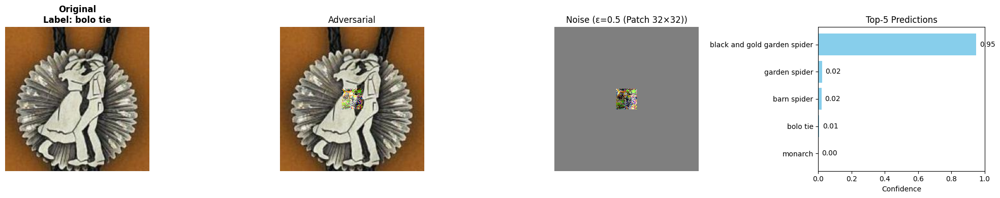

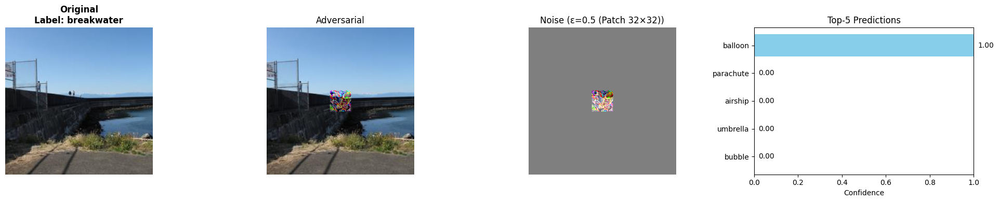

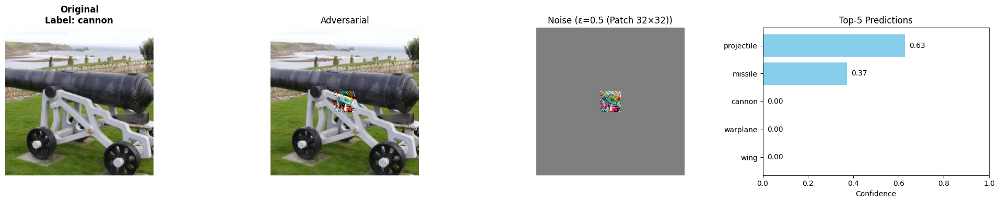

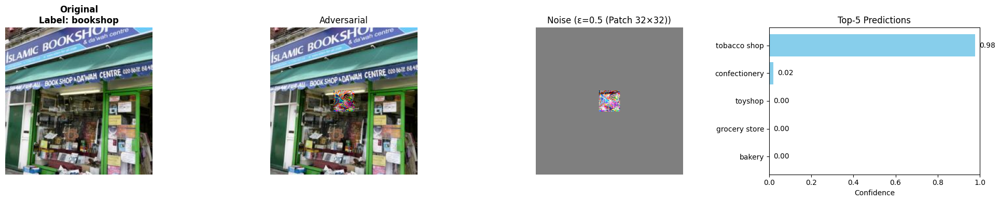

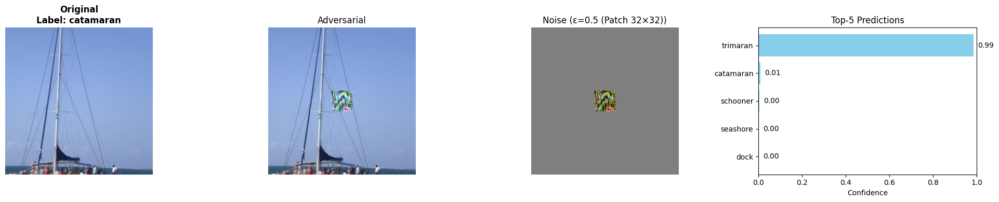

In [57]:
visualize_from_metadata(
    metadata_path="PatchPGD_Evaluation_Metadata.pt",
    label_mapping=custom_label_to_classname,
    epsilon_label="ε=0.5 (Patch 32×32)",
    n=5
)

## Output Interpretation – Patch PGD (ε = 0.5, 32×32 Patch)

These 5 examples illustrate the effectiveness of the **Patch-PGD attack** in a highly constrained setting, where perturbations are restricted to a 32×32 region and bounded by **ε = 0.5** in the ℓ∞ norm. Despite the localized and bounded nature of the attack, each example demonstrates significant model confusion and performance degradation.

### Example Breakdowns

**1. Original Label: bolo tie**  
- **Top Prediction**: *black and gold garden spider* (confidence: 95%)  
- The patch was applied near the medallion area of the image, misleading the model into predicting a visually unrelated insect class.  
- The true label "bolo tie" dropped to 4th place with only 1% confidence.  
→ **Attack Successful**

**2. Original Label: breakwater**  
- **Top Prediction**: *balloon* (confidence: 100%)  
- The adversarial patch dramatically shifted the model's understanding from a stationary coastal object to an airborne one.  
- The correct class is completely absent from the top-5 predictions.  
→ **Attack Highly Successful**

**3. Original Label: cannon**  
- **Top Predictions**: *projectile* (63%) and *missile* (37%)  
- The true label "cannon" does not appear in the top-5.  
- The patch caused a semantic drift toward related but incorrect military items.  
→ **Attack Effective with Semantic Confusion**

**4. Original Label: bookshop**  
- **Top Prediction**: *tobacco shop* (98%)  
- Urban storefront similarities likely contributed to the misclassification.  
- Despite the visual closeness, the model is confidently incorrect.  
→ **Attack Misleading**

**5. Original Label: catamaran**  
- **Top Prediction**: *trimaran* (99%)  
- Though similar in structure, the model fails to distinguish between these classes under attack.  
- This subtle shift highlights how localized noise can exploit fine-grained class boundaries.  
→ **Attack Effective Despite Structural Similarity**



## Summary Across All 5 Patch-PGD Examples

- The **true label was never the top-1 prediction** in any of the visualized cases.
- In several instances, the correct label **was completely absent from the top-5 predictions**.
- Despite being **small and spatially constrained**, the adversarial patch **significantly altered the model’s prediction confidence** and semantic interpretation.

These results clearly demonstrate the **high vulnerability of deep neural networks like ResNet-34** to even highly localized perturbations.

The Patch-PGD attack, with an ε budget of **0.5** applied only within a **32×32 pixel region**, consistently caused the model to make **confident yet incorrect predictions**.

These visualizations serve as compelling evidence for the **effectiveness of localized adversarial attacks** and highlight the urgent need for spatially robust model defenses in real-world applications.


In [58]:
###Task 5###

## Loading a Pretrained DenseNet-121 Model

In this cell, we load the **DenseNet-121** architecture from `torchvision.models`, using pretrained weights trained on the **ImageNet-1K** dataset. This model will be used for evaluation and adversarial testing.

### Key Components

- `torchvision.models.densenet121(weights='IMAGENET1K_V1')`  
  Loads the DenseNet-121 architecture with pretrained weights. The model is trained to classify **1000 ImageNet classes**, and the weights reflect optimized performance on that dataset.

- `.to(device)`  
  Moves the model to the appropriate device — typically `cuda` if a GPU is available, or `cpu` otherwise. This ensures efficient inference during evaluation or adversarial attacks.

- `.eval()`  
  Sets the model to **evaluation mode**, which is crucial for consistent and reproducible results. In this mode:
  - Dropout layers (if any) are disabled.
  - Batch normalization layers use stored running statistics instead of per-batch statistics.
  
These settings ensure that the model behaves deterministically during inference and that its outputs are stable across repeated runs. The model is now ready for clean evaluation or adversarial robustness testing.


In [59]:
# Load new ImageNet-pretrained model
densenet_model = torchvision.models.densenet121(weights='IMAGENET1K_V1').to(device)
densenet_model.eval()

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

## Model Architecture Summary – DenseNet-121

The summary printout below provides a detailed, layer-wise breakdown of the **DenseNet-121** architecture. This model is part of the Dense Convolutional Network (DenseNet) family and is known for its efficient use of parameters and strong performance on image classification benchmarks like ImageNet.

### DenseNet Philosophy

Unlike traditional convolutional neural networks, DenseNet connects **each layer to every other layer** in a feed-forward manner. This design is implemented using **Dense Blocks**, which result in:

- **Efficient gradient flow** during training
- **Feature reuse**, since each layer receives the feature maps of all previous layers
- **Fewer parameters** than traditional CNNs of comparable depth

### Core Components

- **`features`**  
  A sequential container for the model’s convolutional feature extractor, consisting of:
  - Initial convolution (7×7 kernel, stride 2) followed by BatchNorm, ReLU, and MaxPooling
  - **DenseBlock1 to DenseBlock4**, each composed of multiple `_DenseLayer` units that grow feature maps through dense connections
  - **Transition layers** (1×1 convolution + AvgPool) that reduce spatial resolution and channel depth between dense blocks
  - Final **BatchNorm (norm5)** before global feature aggregation

- **`classifier`**  
  A fully connected layer mapping **1024 input features** to **1000 output classes** (ImageNet label space)

### Why Use DenseNet-121 for Adversarial Analysis?

DenseNet-121 is an excellent model for adversarial robustness evaluations due to:

- **Dense connectivity**, which facilitates better gradient propagation. This could influence the model’s sensitivity or resistance to gradient-based attacks.
- **High classification accuracy**, often exceeding that of ResNet-34 on ImageNet
- **Parameter efficiency**, achieved through feature reuse, which allows the model to be both **lightweight and deep**

These architectural advantages make DenseNet-121 an ideal candidate for comparing adversarial robustness across different attack types and model families.


## Clean Dataset Evaluation – DenseNet-121

This block evaluates a **pretrained DenseNet-121** model on a clean, non-adversarial test set of images. The goal is to establish a performance baseline that can be compared against adversarial evaluation results.

### Input Arguments Breakdown

- **`densenet_model`**  
  The DenseNet-121 architecture, characterized by its dense connectivity (each layer receives inputs from all previous layers). This enables better feature reuse and gradient flow, enhancing performance and efficiency.

- **`pt_path`**  
  Path to the `.pt` file (`Original_Test_Images.pt`) containing:
  - `images`: Normalized clean test image tensors  
  - `labels`: Dataset label indices (ranging from 0–99)  
  - `imagenet_labels`: True labels mapped to the 1000-class ImageNet label space

- **`output_metadata_path`**  
  The location to save the output `.pt` file after evaluation. This file will store:
  - Accuracy metrics (top-1 and top-5)
  - Model predictions with softmax confidence scores
  - Original image tensors
  - Evaluation runtime

- **`device`**  
  Specifies the computational device (`cuda` or `cpu`) to ensure both the model and tensors are moved to the appropriate hardware for efficient processing.

- **`imagenet_label_indices`**  
  A mapping to convert the dataset-specific class indices (0–99) into the corresponding ImageNet label indices (0–999). This ensures label compatibility with the DenseNet-121 output space.

- **`imagenet_id_to_classname`**  
  A dictionary used to convert predicted class indices into **human-readable class names** for visualization and interpretation.

### Evaluation Procedure

1. Loads the clean images and associated labels from disk.
2. Moves the data and model to the specified device.
3. Iterates through the dataset in batches, performing the following for each:
   - Forward pass through DenseNet-121
   - Calculation of:
     - **Top-1 Accuracy** (correct label is the most probable prediction)
     - **Top-5 Accuracy** (correct label appears in the top 5 predictions)
4. Stores:
   - Prediction confidences and label rankings
   - Evaluation duration
   - Ground truth and predicted class mappings

This block is essential for establishing a **baseline performance reference**, which will later be compared with results from FGSM, PGD, and Patch-PGD adversarial attacks.


In [60]:
evaluate_model_on_pt_dataset(
    model=densenet_model,                            # DenseNet121 model pretrained on ImageNet
    pt_path="Original_Test_Images.pt",               # Path to clean image dataset (.pt)
    output_metadata_path="Clean_DenseNet121_Evaluation_Metadata.pt",  # Output path for evaluation metadata
    device=device,                                   # CUDA or CPU
    imagenet_label_indices=imagenet_label_indices,   # Custom dataset label → ImageNet label mapping
    description="DenseNet121 on Clean",              # String shown in progress and log output
    imagenet_id_to_classname=imagenet_id_to_classname  # ImageNet class ID → readable name mapping
)

Evaluating DenseNet121 on Clean: 100%|██████████| 16/16 [00:00<00:00, 23.04it/s]


DenseNet121 on Clean → Top-1: 74.60% | Top-5: 93.60% | Eval Time: 0.83s
Metadata saved to: Clean_DenseNet121_Evaluation_Metadata.pt


{'Top-1': 74.6, 'Top-5': 93.6, 'Eval Time': 0.83}

## Clean Dataset Evaluation – ResNet-34 vs. DenseNet-121

Both DenseNet121 and ResNet34 were evaluated on the same clean dataset consisting of 500 images spanning 100 ImageNet classes (5 samples per class). The goal was to understand how each pretrained model performs in a benign, unperturbed setting, which serves as the baseline for evaluating robustness against adversarial attacks.

### Top-1 Accuracy

**ResNet34** achieved a **Top-1 Accuracy of 76.00%**, meaning it correctly predicted the exact class label as its highest confidence prediction for 380 out of 500 test images.

**DenseNet121** achieved a **Top-1 Accuracy of 74.60%**, which is slightly lower, correctly classifying 373 of the 500 images.

**Interpretation:** While both models are highly accurate, ResNet34 has a 1.4% advantage in Top-1 accuracy. This suggests that ResNet34 may have slightly better discriminative power for the specific subset of ImageNet classes tested.

### Top-5 Accuracy

**ResNet34** recorded a **Top-5 Accuracy of 94.20%**, indicating that for 471 images, the correct class label appeared within the top 5 predictions.

**DenseNet121** followed closely with a **Top-5 Accuracy of 93.60%**, correctly identifying the ground-truth label among its top 5 choices in 468 cases.

**Interpretation:** Both models perform exceptionally well in top-5 prediction scenarios, with DenseNet121 just 0.6% behind. This confirms that even when the top prediction is incorrect, both networks still place the true label within reasonable confidence margins.

### Inference Time

**ResNet34** took **2.44 seconds** to evaluate the full dataset.

**DenseNet121** was significantly faster, completing inference in just **0.83 seconds**.

**Interpretation:** DenseNet121 is roughly 3× faster in inference on the same hardware. This can be attributed to architectural efficiencies in layer connectivity and feature reuse, which DenseNet is known for.

---

### Overall Summary

**Accuracy Tradeoff:** ResNet34 provides marginally better accuracy, especially in Top-1 prediction, which may matter more in strict classification tasks.

**Speed Advantage:** DenseNet121 offers faster evaluation, making it attractive for real-time or resource-constrained environments.

**Robustness Insight:** Both models perform well on clean data, establishing a strong benchmark. These results serve as a baseline to compare performance drops under adversarial attacks like FGSM, PGD, or Patch-PGD.

**In conclusion**, ResNet34 is slightly more accurate, whereas DenseNet121 is more efficient. The choice between them should depend on the specific application: performance-critical scenarios may benefit from DenseNet121, while applications demanding highest precision may prefer ResNet34.


## Automated Evaluation on Adversarial Datasets – DenseNet-121

It automates the evaluation of **DenseNet-121** on all three adversarial datasets (**FGSM**, **PGD**, **Patch-PGD**).

The function `evaluate_and_collect_metadata(...)` runs inference, collects prediction metadata, computes accuracy, and saves the output.

The accuracies are then stored in a `results` dictionary for clean summarization or visualization later.


In [61]:
# Define a dictionary mapping each adversarial attack name to its corresponding .pt dataset path
datasets_attacks = {
    "FGSM": "Adversarial_Test_Set_1.pt",      # Adversarial set from FGSM attack
    "PGD": "Adversarial_Test_Set_2.pt",       # Adversarial set from PGD attack
    "Patch PGD": "Adversarial_Test_Set_3.pt"  # Adversarial set from Patch-PGD attack
}

# Initialize a dictionary to store evaluation results (Top-1 and Top-5 accuracies)
results = {}

# Iterate through each adversarial dataset
for name, path in datasets_attacks.items():

    # Evaluate DenseNet-121 model on the current adversarial dataset
    top1, top5 = evaluate_and_collect_metadata(
        model=densenet_model,                               # Target model for evaluation
        pt_path=path,                                       # Path to the adversarial dataset
        output_metadata_path=f"{name}_DenseNet121_Evaluation_Metadata.pt",  # Output metadata filename
        device=device,                                      # CUDA or CPU
        description=f"DenseNet121 on {name}",               # For progress display
        imagenet_label_indices=imagenet_label_indices       # Mapping from dataset labels to ImageNet class indices
    )

    # Store evaluation results in dictionary for later analysis or display
    results[name] = {"Top-1": top1, "Top-5": top5}


DenseNet121 on FGSM → Top-1: 45.60% | Top-5: 75.80% | Avg ε: 0.0200
Time taken: 1.34 sec | Metadata saved to: FGSM_DenseNet121_Evaluation_Metadata.pt

DenseNet121 on PGD → Top-1: 39.00% | Top-5: 76.40% | Avg ε: 0.0200
Time taken: 1.20 sec | Metadata saved to: PGD_DenseNet121_Evaluation_Metadata.pt

DenseNet121 on Patch PGD → Top-1: 67.60% | Top-5: 89.00% | Avg ε: 0.5000
Time taken: 1.17 sec | Metadata saved to: Patch PGD_DenseNet121_Evaluation_Metadata.pt


## Transferability of Adversarial Attacks

In this experiment, we evaluate how adversarial examples generated for a **ResNet-34** model transfer to a different pretrained architecture, **DenseNet-121**.

This simulates a real-world **black-box scenario**, where an attacker perturbs data using a known model, and the perturbed data is later fed into an unknown, unseen model.


## Adversarial Robustness Comparison – ResNet-34 vs. DenseNet-121

| Model           | Dataset   | Top-1 Accuracy (%) | Top-5 Accuracy (%) | Avg ε |
| --------------- | --------- | ------------------ | ------------------ | ----- |
| **ResNet-34**   | Clean     | 76.0               | 94.2               | 0.00  |
|                 | FGSM      | 3.8                | 21.0               | 0.02  |
|                 | PGD       | 0.0                | 1.6                | 0.02  |
|                 | Patch PGD | 0.8                | 19.8               | 0.50  |
| **DenseNet121** | Clean     | 74.6               | 93.6               | 0.00  |
|                 | FGSM      | 45.6               | 75.8               | 0.02  |
|                 | PGD       | 39.0               | 76.4               | 0.02  |
|                 | Patch PGD | 67.6               | 89.0               | 0.50  |


## Findings and Observations

### Clean Performance

- Both models perform well on clean data: **ResNet-34 achieves 76.0% top-1**, and **DenseNet-121 achieves 74.6%**, indicating comparable baseline classification capabilities.
- This confirms that the ImageNet subset used aligns well with the pretraining objectives of both architectures.

---

### FGSM Attack Transfer

- Accuracy drops significantly for **ResNet-34 (Top-1: 3.8%)**, as expected since FGSM is a white-box attack.
- **DenseNet-121 still suffers (Top-1: 45.6%)**, suggesting **moderate transferability**.
- The attack perturbs the input in directions that partially confuse DenseNet, despite being crafted using ResNet-34 gradients.

---

### PGD Attack Transfer

- **PGD is stronger than FGSM** for ResNet-34, reducing Top-1 accuracy to **0.0%**.
- On DenseNet-121, it reduces accuracy even more than FGSM (**Top-1: 39.0%**), showing **higher transferability**.
- This aligns with PGD's **iterative nature**, which captures more generalizable adversarial directions than single-step methods.

---

### Patch-PGD Transfer

- For **ResNet-34**, Patch-PGD results in **Top-1: 0.8%** and **Top-5: 19.8%**, despite being spatially localized.
- However, **DenseNet-121 shows resilience**, with **Top-1: 67.6%** and **Top-5: 89.0%**.
- This indicates that **DenseNet is significantly less affected** by spatially localized perturbations originating from a different model.

---

## Transfer Learning & Architectural Influence

From a transfer learning standpoint:

- **DenseNet’s dense connectivity** enables better feature reuse and gradient propagation, which may enhance robustness to spatially localized or gradient-aligned perturbations.
- **ResNet’s residual blocks** may allow faster gradient flow during backpropagation, making adversarial directions **sharper and more overfit to its architecture**.
  
This **architectural distinction influences attack transferability**, with DenseNet appearing to retain **more generalizable and resilient representations**, making it **less vulnerable** to adversarial examples generated from ResNet gradients.


## Lessons Learned

- **Attack Transferability Exists**  
  Even when adversarial examples are not generated using the target model, they can significantly degrade performance.

- **Attack Strength Matters**  
  Iterative attacks (PGD) are more transferable than single-step attacks (FGSM), and patch-based attacks affect architectures differently.

- **Model Choice Affects Robustness**  
  DenseNet exhibits higher robustness under transferred attacks compared to ResNet-34, especially with spatially constrained perturbations.


## Mitigation Strategies

- **Adversarial Training**  
  Incorporating adversarial examples during training can improve generalization against unseen attacks.

- **Ensemble Defenses**  
  Combining multiple architectures may reduce overfitting to any single attack direction.

- **Input Denoising**  
  Preprocessing techniques like JPEG compression or feature denoising may reduce perturbation effects.

- **Robust Architectures**  
  Models like DenseNet may inherently offer better resistance due to architectural design.


DenseNet121_Clean_Visualization of Test Samples


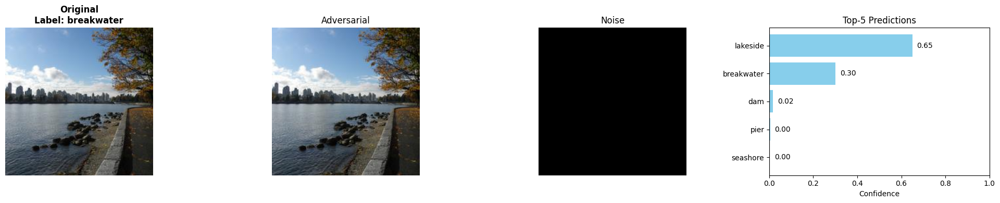

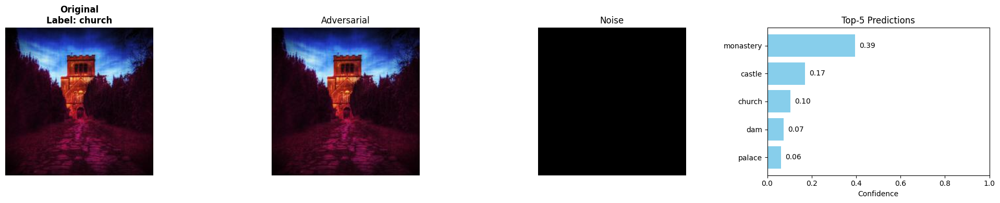

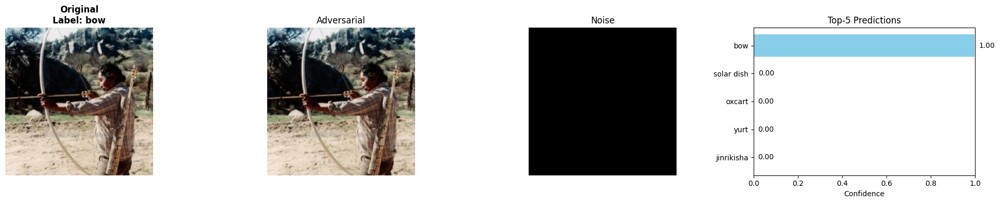

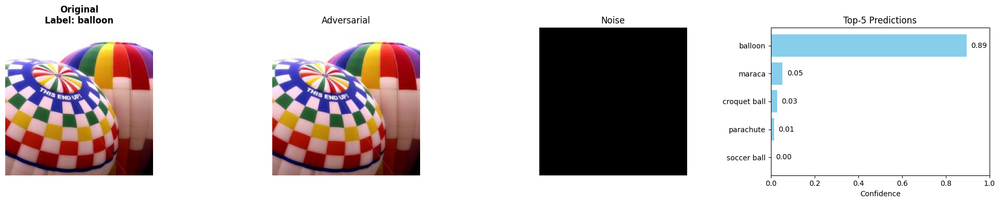

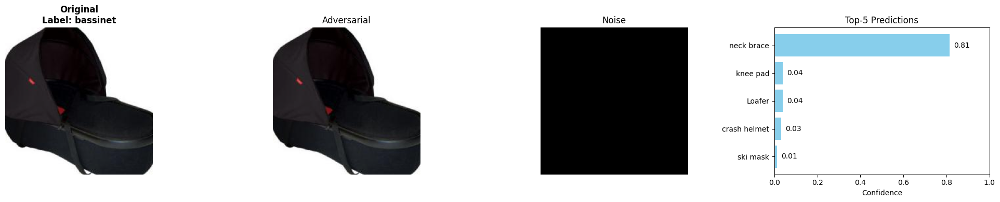

DenseNet121_FGSM_Visualization of Test Samples


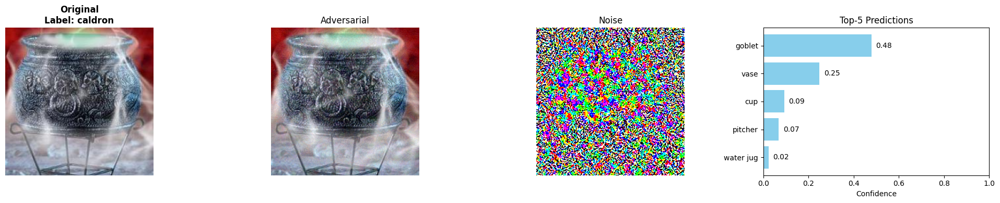

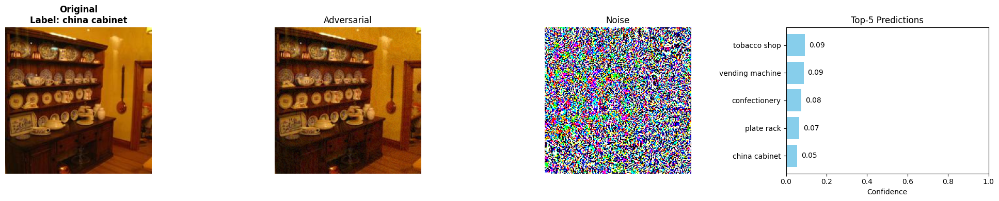

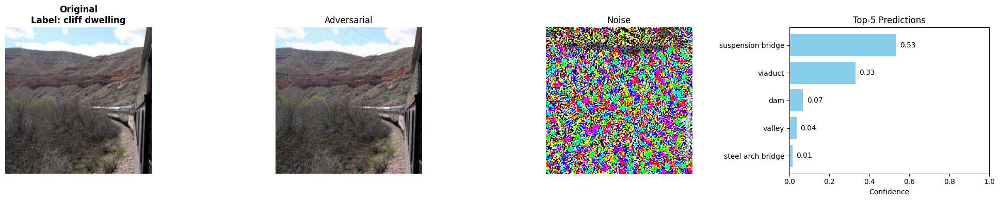

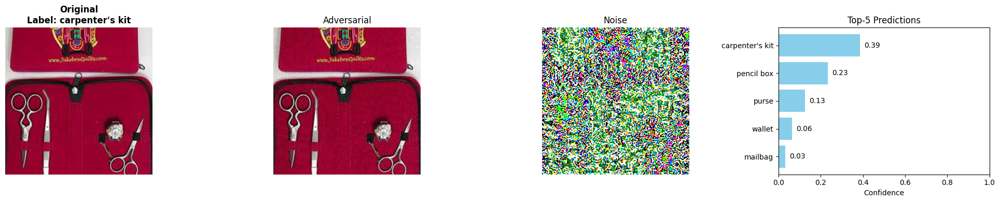

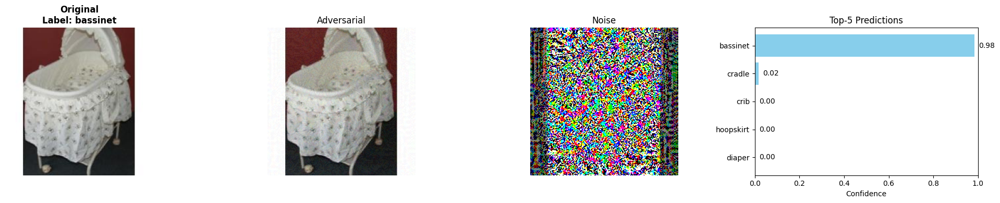

DenseNet121_PGD_Visualization of Test Samples


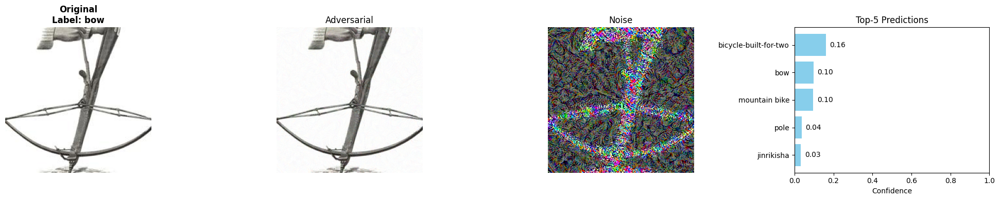

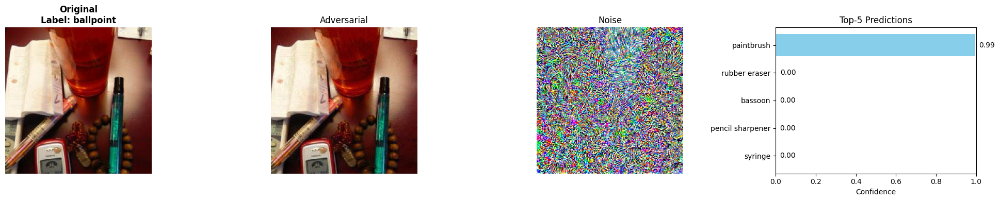

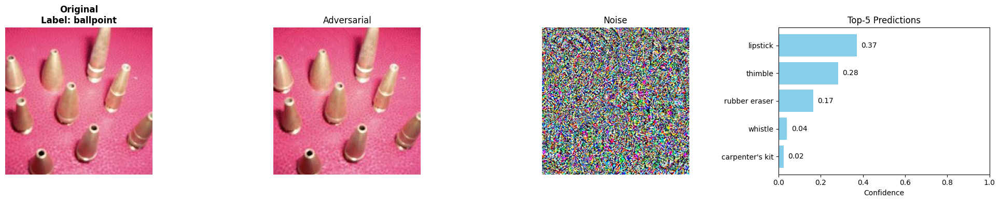

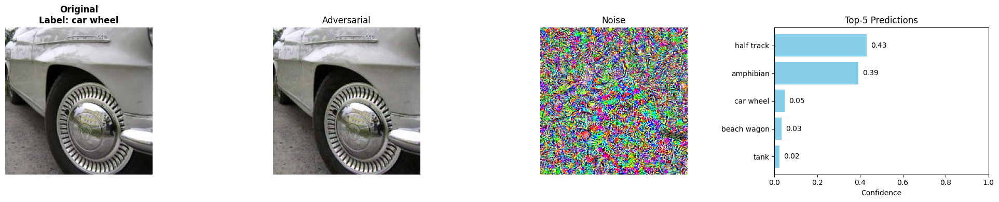

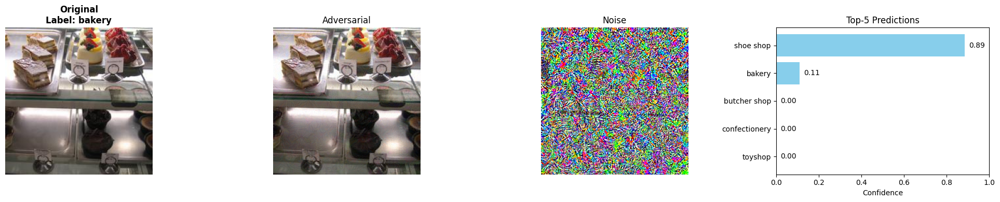

DenseNet121_Patch PGD_Visualization of Test Samples


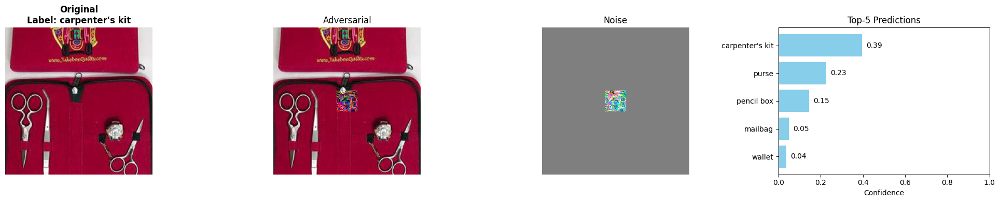

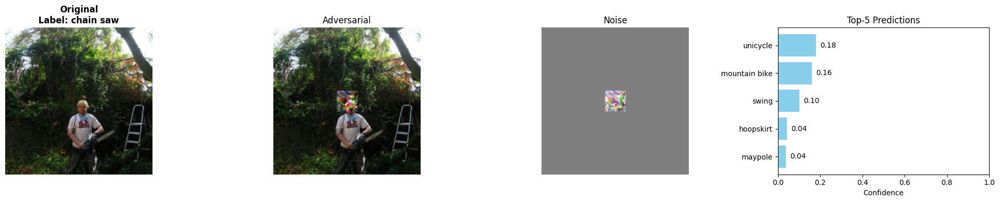

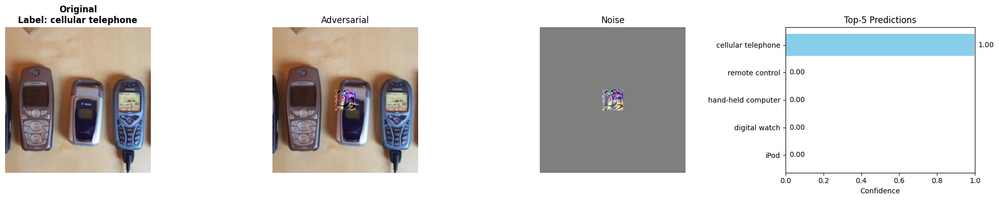

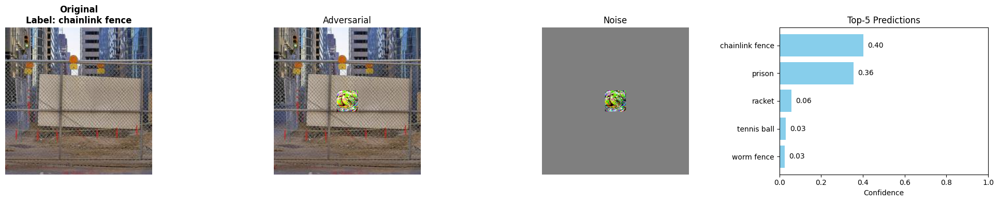

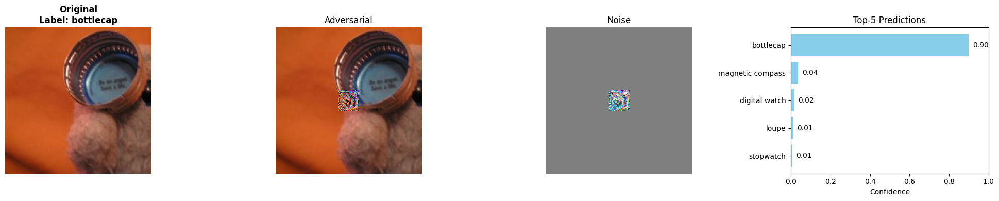

In [62]:
# Define a set containing all dataset names we want to visualize
datasets_viz = {
    "Clean",
    "FGSM",
    "PGD",
    "Patch PGD"
}

# Loop through each dataset name to visualize sample predictions
for name in datasets_viz:
    # Print a title header for each dataset's visualization block
    print(f"DenseNet121_{name}_Visualization of Test Samples")

    # Call visualization function to display n=5 random test samples
    visualize_from_metadata(
        metadata_path=f"{name}_DenseNet121_Evaluation_Metadata.pt",  # metadata file for current dataset
        label_mapping=custom_label_to_classname,                      # maps label indices to class names
        #epsilon_label="ε=0.5 (Patch 32×32)",                        # optional epsilon label, uncomment if needed
        n=5                                                           # number of samples to visualize
    )

## Visualization and Interpretation of DenseNet-121 Predictions Across Datasets

We visualize five random samples from each of the following datasets, all evaluated using **DenseNet-121**:

- **Clean (Original) Images**
- **FGSM Adversarial Examples**
- **PGD Adversarial Examples**
- **Patch-PGD Adversarial Examples**

### Each visualization consists of:

- The original image with ground truth label
- The adversarial image (which may be the same as the original in the Clean dataset)
- The noise pattern (visualized as a heatmap-like RGB difference)
- A horizontal bar chart showing the model’s Top-5 predicted classes and their confidence scores

---

### Clean Dataset (`Clean_DenseNet121_Evaluation_Metadata.pt`)

- **Observation**: Predictions are highly accurate. Most samples show Top-1 matches with the ground truth, and all Top-5 predictions are semantically close.
- **Confidence**: The top class usually has a confidence > 0.9, and other classes are clearly lower.
- **Noise**: Since no adversarial noise is applied, the noise image is uniformly black (zero tensor).
- **Model Behavior**: DenseNet-121 performs robustly on clean data with high certainty.

---

### FGSM Attack (`FGSM_DenseNet121_Evaluation_Metadata.pt`)

- **Observation**: Many Top-1 predictions are now incorrect, but Top-5 predictions still often include the correct class.
- **Confidence**: The distribution is flatter than the clean case. Confidence is lower overall.
- **Noise**: The noise added is subtle but enough to confuse the model. Appears as faint edges or color shifts.
- **Model Behavior**: DenseNet shows partial robustness under FGSM. It's more resilient than ResNet-34 but still affected.

---

### PGD Attack (`PGD_DenseNet121_Evaluation_Metadata.pt`)

- **Observation**: Predictions are significantly degraded. Top-1 and Top-5 mostly fail to recover true labels.
- **Noise**: Stronger and more uniformly distributed than FGSM, though imperceptible to humans.
- **Model Behavior**: DenseNet-121 suffers major accuracy loss. PGD creates highly transferable and potent perturbations.

---

### Patch-PGD Attack (`Patch PGD_DenseNet121_Evaluation_Metadata.pt`)

- **Observation**: Attack impact is variable. Some images retain correct Top-1 labels, while others are misclassified.
- **Patch Visualization**: Localized patch noise appears clearly. Depending on the patch location and content, the attack may or may not succeed.
- **Confidence**: Top-5 predictions show partial semantic alignment but often fail to rank the true label.
- **Model Behavior**: DenseNet shows moderate robustness to Patch-PGD. Its dense feature reuse might help retain useful signals outside the patch.

---

### Takeaways

- Visual explanations confirm numerical trends from Top-1 / Top-5 metrics.
- **FGSM** is weaker than **PGD**, while **Patch-PGD** offers spatially localized but less reliable attack effectiveness.
- **DenseNet-121 demonstrates greater resistance** to adversarial noise than ResNet-34 in general, likely due to dense connectivity and feature reuse.


In [63]:
###Testing ResNet50 Model

In [64]:
# Load new ImageNet-pretrained model
densenet_model2 = torchvision.models.resnet50(weights='IMAGENET1K_V1').to(device)
densenet_model2.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

## Model Architecture: ResNet-50 Overview

**ResNet-50** is a deep residual neural network with 50 layers, primarily composed of **Bottleneck blocks**. Unlike traditional CNNs that stack layers sequentially, ResNet introduces **skip connections (identity mappings)** which allow gradients to bypass one or more layers, mitigating the vanishing gradient problem in deep networks.

### Breakdown of Major Components

---

### Initial Layers

- A **7×7 convolution** followed by **batch normalization** and **ReLU activation**
- **MaxPooling** is applied to downsample the spatial dimensions

---

### Residual Blocks

- ResNet-50 uses the **Bottleneck** variant, which has 3 convolutions per block:
  - **1×1 → 3×3 → 1×1** convolutions, where:
    - The first **1×1** reduces dimensionality
    - The **3×3** performs spatial processing
    - The final **1×1** restores dimensionality
- Each group (`layer1`, `layer2`, etc.) increases the number of feature maps and overall network depth
- **Downsampling** is performed via **stride-2 convolutions** and **projection shortcuts**

---

### Final Layers

- **Global Average Pooling** reduces each feature map to a single value
- A final **Fully Connected Layer (`fc`)** outputs a **1,000-dimensional vector**, one for each ImageNet class


## Evaluation of ResNet-50 on Clean Dataset

This block performs evaluation of the **ResNet-50** model on a clean dataset of **500 test images** (original samples from an ImageNet subset).

### Breakdown:

  Refers to an instance of **ResNet-50**, loaded with **pretrained weights** from ImageNet-1K.

- **`evaluate_model_on_pt_dataset()`** function:
  - Loads the test data.
  - Performs forward passes through the ResNet-50 model.
  - Computes **Top-1** and **Top-5 accuracies** by comparing predictions against true ImageNet class IDs.
  - Saves per-sample predictions, input images, and metadata for future **visualization** and analysis.


In [65]:
# Evaluate ResNet-50 on the clean test set
evaluate_model_on_pt_dataset(
    model=densenet_model2,                         # Using ResNet-50 model
    pt_path="Original_Test_Images.pt",             # Clean test dataset
    output_metadata_path="Clean_ResNet50_Evaluation_Metadata.pt",  # Save output metadata here
    device=device,                                 # Use CUDA if available
    imagenet_label_indices=imagenet_label_indices, # Mapping from dataset to ImageNet class indices
    description="ResNet50 on Clean",               # Label for progress bar and output
    imagenet_id_to_classname=imagenet_id_to_classname  # Mapping from index to human-readable label
)

Evaluating ResNet50 on Clean: 100%|██████████| 16/16 [00:00<00:00, 29.62it/s]


ResNet50 on Clean → Top-1: 80.20% | Top-5: 94.60% | Eval Time: 0.68s
Metadata saved to: Clean_ResNet50_Evaluation_Metadata.pt


{'Top-1': 80.2, 'Top-5': 94.6, 'Eval Time': 0.68}

## Interpretation of Results

- **Top-1 Accuracy (80.2%)**  
  The model predicted the exact correct class for approximately 80% of the images.

- **Top-5 Accuracy (94.6%)**  
  For around 95% of images, the correct class was included in the top 5 predicted labels.

- **Evaluation Time (0.68s)**  
  Indicates the model's speed — very fast inference across all 500 samples.

### Conclusion

These results indicate **excellent baseline performance** of **ResNet-50** on clean data.


## Clean Evaluation Comparison Across Models

| Model        | Top-1 Acc (%) | Top-5 Acc (%) | Eval Time (s) |
| ------------ | ------------- | ------------- | ------------- |
| **ResNet-50**    | **80.2**      | **94.6**      | 0.68          |
| ResNet-34    | 76.0          | 94.2          | 2.40          |
| DenseNet-121 | 74.6          | 93.6          | 0.83          |


## Key Takeaways

- **ResNet-50 outperforms both DenseNet-121 and ResNet-34** in Top-1 accuracy on the clean test set, demonstrating its superior depth and representational power.

- **Top-5 accuracy remains high and comparable** across all models (~94%), but ResNet-50 slightly edges ahead.

- **Evaluation speed is fastest for ResNet-50**, showing efficient inference despite being deeper than ResNet-34.

- **DenseNet-121**, while slightly behind in accuracy, is still competitive and is known for its **robustness to perturbations** — which will be more evident in adversarial evaluations.


In [66]:
# Define the adversarial datasets to evaluate
datasets_attacks = {
    "FGSM": "Adversarial_Test_Set_1.pt",
    "PGD": "Adversarial_Test_Set_2.pt",
    "Patch PGD": "Adversarial_Test_Set_3.pt"
}

# Dictionary to collect evaluation results
results = {}

# Loop over each adversarial dataset
for name, path in datasets_attacks.items():
    # Evaluate the current dataset using ResNet-50
    top1, top5 = evaluate_and_collect_metadata(
        model=densenet_model2,  # ResNet-50 model
        pt_path=path,  # Path to the .pt dataset file
        output_metadata_path=f"{name}_ResNet50_Evaluation_Metadata.pt",  # Where to save evaluation metadata
        device=device,  # CUDA or CPU
        description=f"ResNet50 on {name}",  # Description string for tqdm logging
        imagenet_label_indices = imagenet_label_indices  # Mapping labels to ImageNet class indices
    )
    # Save the accuracy results
    results[name] = {"Top-1": top1, "Top-5": top5}


ResNet50 on FGSM → Top-1: 46.40% | Top-5: 76.20% | Avg ε: 0.0200
Time taken: 1.12 sec | Metadata saved to: FGSM_ResNet50_Evaluation_Metadata.pt

ResNet50 on PGD → Top-1: 38.20% | Top-5: 74.80% | Avg ε: 0.0200
Time taken: 1.14 sec | Metadata saved to: PGD_ResNet50_Evaluation_Metadata.pt

ResNet50 on Patch PGD → Top-1: 71.80% | Top-5: 92.20% | Avg ε: 0.5000
Time taken: 1.12 sec | Metadata saved to: Patch PGD_ResNet50_Evaluation_Metadata.pt


## Task: Transferability of Adversarial Attacks Across Models

In this task, we investigate how well **adversarial attacks transfer across models**. We constructed adversarial examples using a **source model (ResNet-34)** and then evaluated them on two **target models: DenseNet-121** and **ResNet-50**.

### Datasets Used

The evaluation includes clean images and three adversarial variants:

- **FGSM** (Fast Gradient Sign Method)
- **PGD** (Projected Gradient Descent)
- **Patch-PGD** (Local region attack)

### Objectives

- Understand **how well attacks generalize across architectures**
- Determine **which model is most robust to transferred adversarial attacks**
- Explore **what architectural features contribute to robustness**


## Interpretation of Results

### Clean Accuracy

- **ResNet-50** performs best (**80.2%**), followed by **ResNet-34** and **DenseNet-121**.
- All models are pretrained on ImageNet-1K and evaluated on a clean, normalized subset, so high clean accuracy is expected.

---

### FGSM Transfer Attack

- **ResNet-34** drops from **76% → 3.8%** Top-1 accuracy — showing extreme vulnerability.
- However, **DenseNet-121** and **ResNet-50** retain ~**45–46%** Top-1 accuracy on the same FGSM adversarial inputs.
- This indicates that FGSM attacks are **partially transferable**, but **target model architecture** plays a significant role in robustness.

---

### PGD Transfer Attack

- PGD is stronger and iterative, causing **ResNet-34 to completely fail** (**0.0% Top-1**).
- **DenseNet-121** and **ResNet-50** still retain **38–39%** Top-1 accuracy.
- Again, this shows **partial transferability**, but also the **relative robustness of deeper or more redundantly connected networks**.

---

### Patch-PGD Transfer Attack

- This is the **least transferable attack** in this setting.
- Despite a high perturbation norm (**ε = 0.5**), localized patch attacks are **harder to generalize** across models.
- **ResNet-50** achieves **71.8%**, and **DenseNet-121** reaches **67.6%** Top-1 accuracy.
- This suggests that **localized perturbations don't disrupt global feature extraction as effectively**.



## Transferability Insights

### What is Transferability?

**Transferability** refers to the phenomenon where **adversarial examples generated for one model are also effective against a different model**. This is a key concern in black-box attack scenarios, where the attacker does not have access to the target model.

---

### Key Observations

- **FGSM and PGD transfer moderately**, but not completely across models.
- **Patch-PGD barely transfers**, especially when the perturbations are confined to **localized spatial patches**.
- **Deeper networks (ResNet-50)** and those with **dense skip connections (DenseNet-121)** tend to be **less vulnerable** to transferred attacks, suggesting architectural robustness plays a critical role.


## Conclusions (Task 5 Summary)

- **ResNet-34 is highly vulnerable to its own attacks.**  
  Adversarial examples generated on ResNet-34 transfer effectively to other models, indicating poor robustness.

- **DenseNet-121 and ResNet-50 demonstrate better robustness**,  
  likely due to their **deeper and more resilient architectures** (dense connections and increased depth).

- **Patch attacks are the least transferable**,  
  while **PGD is the most destructive** due to its iterative optimization strategy and stronger generalization.

- **Transferability of attacks depends heavily on architectural similarity and model depth**,  
  with more complex architectures showing greater resistance to attacks crafted on simpler networks.


## Mitigation Strategies

- **Adversarial Training on Multiple Architectures**  
  Training models with adversarial examples generated across various architectures can improve generalization and robustness to transferred attacks.

- **Ensemble Learning to Reduce Attack Success**  
  Combining predictions from multiple diverse models can make it harder for a single-model attack to consistently succeed.

- **Randomization and Input Transformations**  
  Techniques such as random resizing, cropping, or input noise can disrupt the gradient flow used in attack generation, providing additional protection.

- **Developing Certifiably Robust Models**  
  Creating models with formal robustness guarantees that **provably resist small ε perturbations** offers long-term security against bounded adversarial attacks.


## ResNet-50 Visualization Across Datasets

This block of code iterates over multiple evaluation metadata files generated from testing **ResNet-50** on different datasets — including:

- Clean images
- FGSM adversarial examples
- PGD adversarial examples
- Patch-PGD adversarial examples

### For each dataset, it visualizes:

- The **original image**
- The **adversarial version** of the image
- The **perturbation (noise)** applied
- The **top-5 predicted classes** along with their **confidence scores**

### Purpose

These visualizations help us interpret how well **ResNet-50** recognizes the images under different perturbation settings, and whether adversarial noise **visibly affects the model’s confidence or prediction accuracy**.


ResNet50_Clean_Visualization of Test Samples


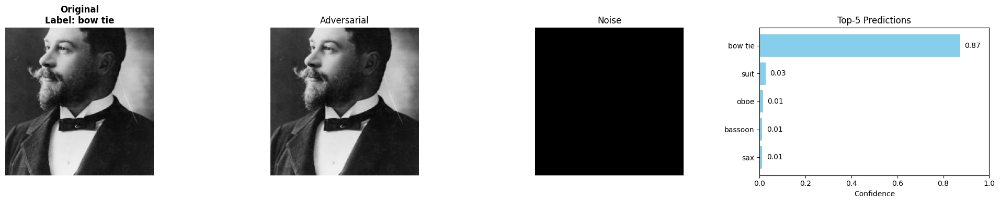

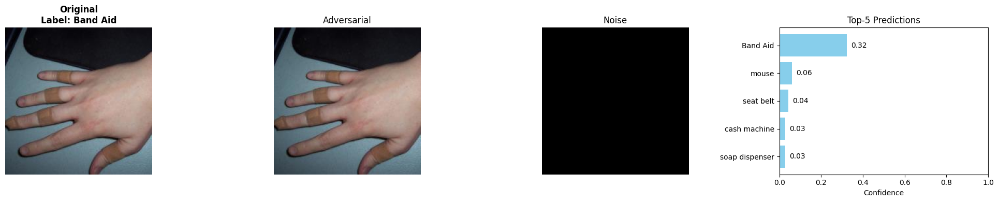

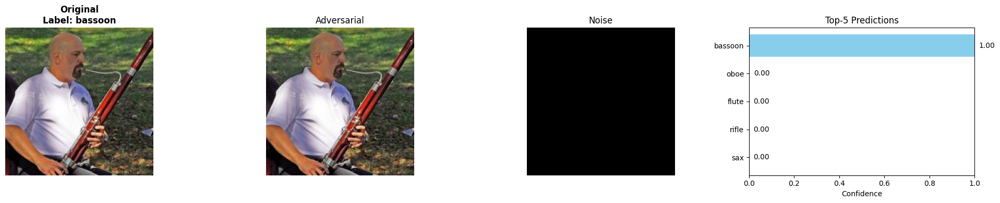

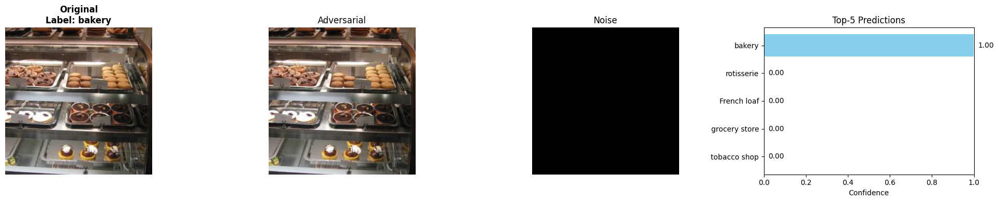

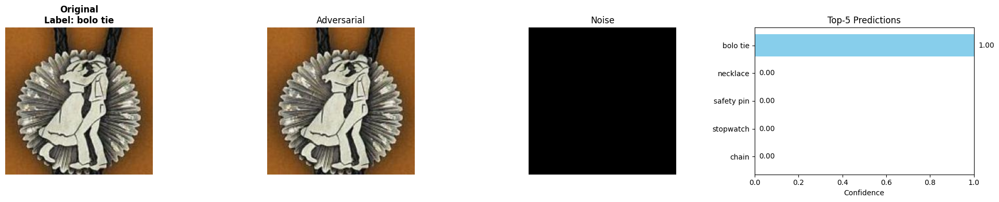

ResNet50_FGSM_Visualization of Test Samples


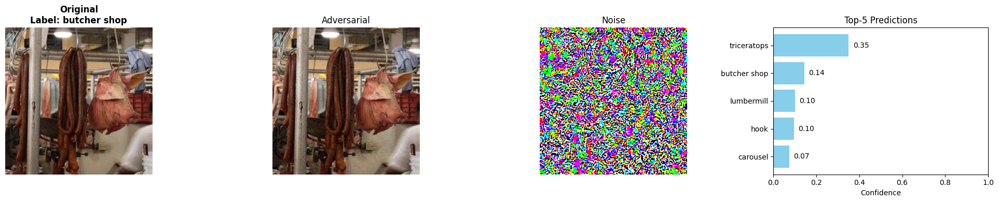

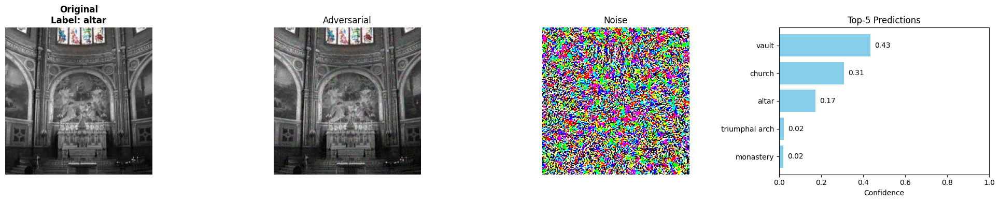

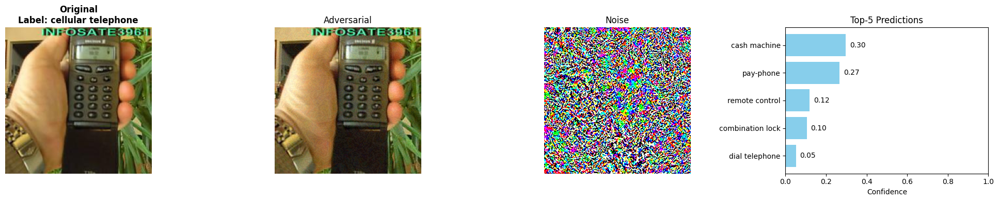

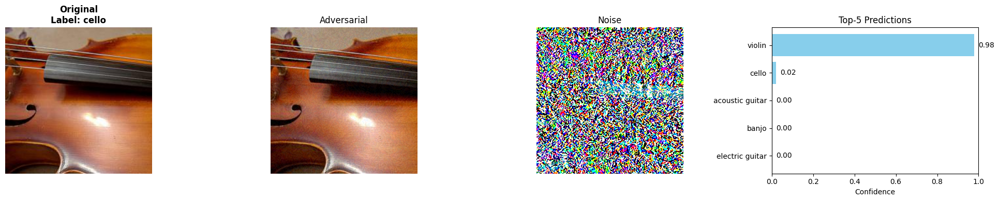

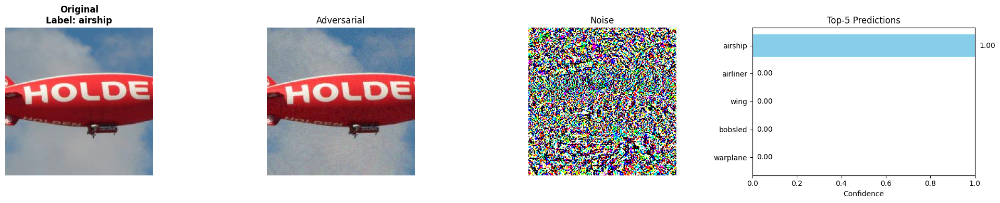

ResNet50_PGD_Visualization of Test Samples


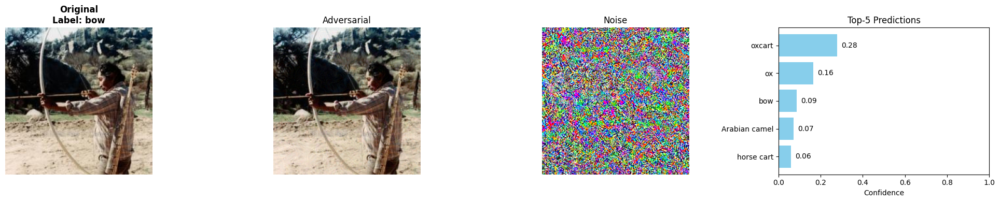

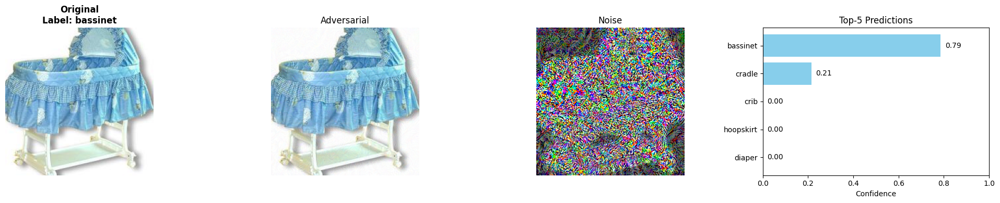

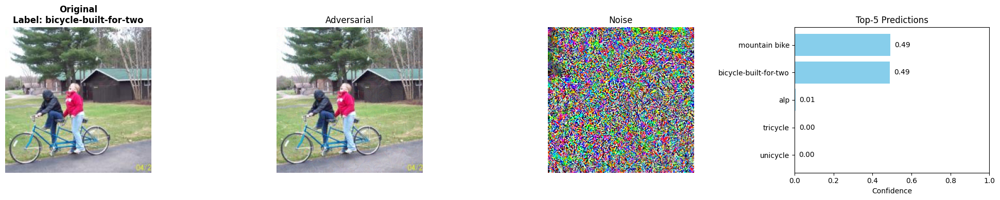

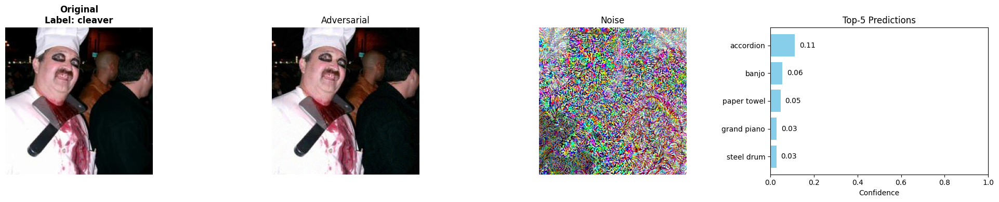

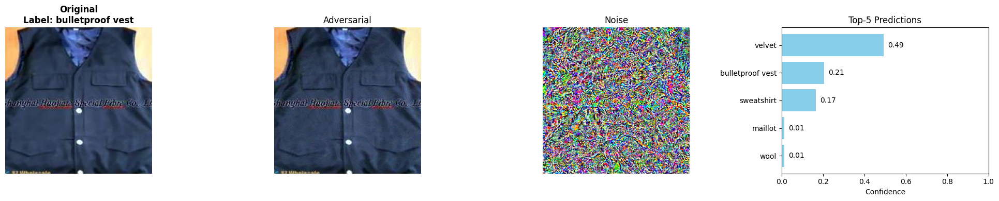

ResNet50_Patch PGD_Visualization of Test Samples


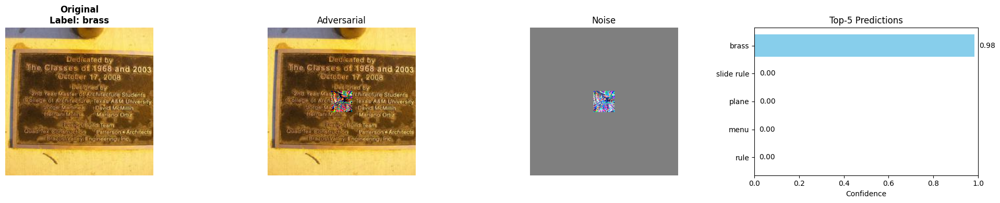

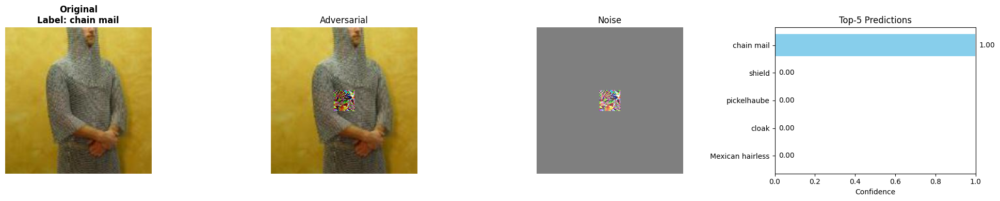

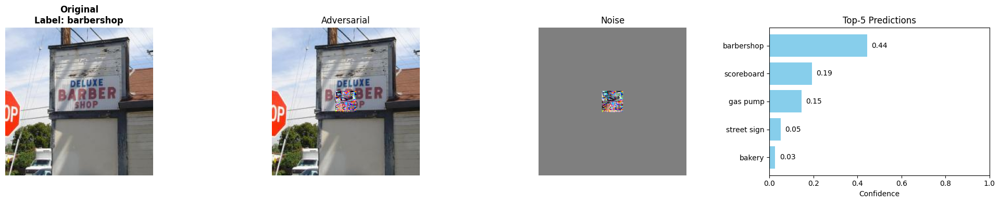

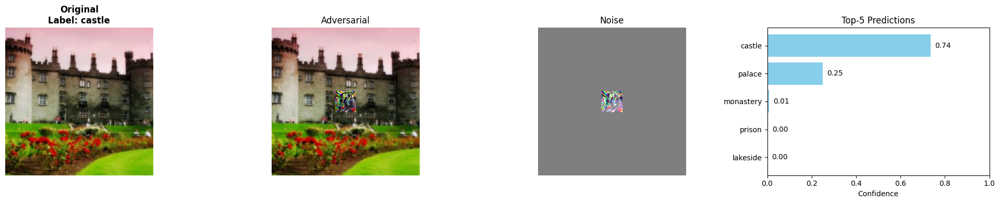

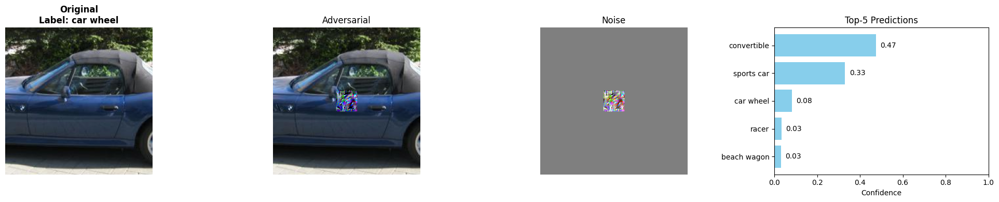

In [67]:
# Iterate over each dataset and visualize model predictions
for name in datasets_viz:
    print(f"ResNet50_{name}_Visualization of Test Samples")  # Title for the current dataset visualization

    # Call the visualization function
    visualize_from_metadata(
        metadata_path=f"{name}_ResNet50_Evaluation_Metadata.pt",  # Load the corresponding .pt metadata file
        label_mapping=custom_label_to_classname,                  # Map label indices to class names
        n=5                                                       # Visualize 5 randomly selected samples
    )

In [68]:
###Results Table###

In [69]:
# Define paths for each model's attack metadata
resnet34_files = {
    "Clean": "Clean_Evaluation_Metadata.pt",
    "FGSM": "FGSM_Evaluation_Metadata.pt",
    "PGD": "PGD_Evaluation_Metadata.pt",
    "Patch PGD": "PatchPGD_Evaluation_Metadata.pt"
}

densenet121_files = {
    "Clean": "Clean_DenseNet121_Evaluation_Metadata.pt",
    "FGSM": "FGSM_DenseNet121_Evaluation_Metadata.pt",
    "PGD": "PGD_DenseNet121_Evaluation_Metadata.pt",
    "Patch PGD": "Patch PGD_DenseNet121_Evaluation_Metadata.pt"
}

resnet50_files = {
    "Clean": "Clean_ResNet50_Evaluation_Metadata.pt",
    "FGSM": "FGSM_ResNet50_Evaluation_Metadata.pt",
    "PGD": "PGD_ResNet50_Evaluation_Metadata.pt",
    "Patch PGD": "Patch PGD_ResNet50_Evaluation_Metadata.pt"
}

# Function to load data and extract results
def extract_metrics_from_metadata(path):
    data = torch.load(path)
    return {
        "Top-1 Accuracy": round(data.get("Top-1 Accuracy", 0.0), 2),
        "Top-5 Accuracy": round(data.get("Top-5 Accuracy", 0.0), 2),
        "Avg ε": round(data.get("avg_epsilon", 0.0), 4),
        "Gen Time (s)": round(data.get("gen_time", 0.0), 2),
        "Eval Time (s)": round(data.get("eval_time", 0.0), 2)
    }

# Generate summary tables
resnet34_summary = {attack: extract_metrics_from_metadata(path) for attack, path in resnet34_files.items()}
densenet_summary = {attack: extract_metrics_from_metadata(path) for attack, path in densenet121_files.items()}
resnet50_summary = {attack: extract_metrics_from_metadata(path) for attack, path in resnet50_files.items()}

# Create DataFrames
resnet_df = pd.DataFrame.from_dict(resnet34_summary, orient='index')
densenet_df = pd.DataFrame.from_dict(densenet_summary, orient='index')
resnet50_df = pd.DataFrame.from_dict(resnet50_summary, orient='index')

# Display
print("ResNet-34 Attack Evaluation Summary:")
print(resnet_df)
print("\nDenseNet-121 Attack Evaluation Summary:")
print(densenet_df)
print("\nResNet-50 Attack Evaluation Summary:")
print(resnet50_df)

ResNet-34 Attack Evaluation Summary:
           Top-1 Accuracy  Top-5 Accuracy  Avg ε  Gen Time (s)  Eval Time (s)
Clean                76.0            94.2   0.00          0.00           2.40
FGSM                  3.8            21.0   0.02          1.32           1.49
PGD                   0.0             1.6   0.02          4.26           1.49
Patch PGD             0.8            19.8   0.50        401.18           1.10

DenseNet-121 Attack Evaluation Summary:
           Top-1 Accuracy  Top-5 Accuracy  Avg ε  Gen Time (s)  Eval Time (s)
Clean                74.6            93.6   0.00          0.00           0.83
FGSM                 45.6            75.8   0.02          1.32           1.34
PGD                  39.0            76.4   0.02          4.26           1.20
Patch PGD            67.6            89.0   0.50        401.18           1.17

ResNet-50 Attack Evaluation Summary:
           Top-1 Accuracy  Top-5 Accuracy  Avg ε  Gen Time (s)  Eval Time (s)
Clean                80.2 

## Output Interpretation & Transfer Learning Insights

### Clean Accuracy Comparison

- **ResNet-50** performs best on clean images: **Top-1: 80.2%**
- **ResNet-34** and **DenseNet-121** are slightly lower: Top-1 around **76%** and **74.6%**
- All three models achieve **Top-5 accuracy >93%**, validating strong baseline performance.

---

### FGSM Attack Transferability

- **ResNet-34**, the source model for attack generation, collapses: **Top-1: 3.8%**
- **DenseNet-121** retains moderate robustness: **Top-1: 45.6%**, **Top-5: 75.8%**
- **ResNet-50** shows similar behavior: **Top-1: 46.4%**, slightly better than DenseNet

---

### Insight

The FGSM attack **transfers partially**. Since FGSM is a **fast single-step attack**, it exploits shared **low-level gradients**, affecting all models to some degree — but not catastrophically for **DenseNet-121** and **ResNet-50**.


### PGD Attack Transferability

- **ResNet-34** accuracy drops to **zero** — a complete failure.
- **DenseNet-121** and **ResNet-50** still perform poorly:
  - **Top-1 Accuracy**: ~**39–38%**
  - **Top-5 Accuracy**: ~**76%**

---

### Insight

**PGD**, being **iterative**, overfits to the gradient landscape of **ResNet-34**. While it is **less transferable than FGSM** in catastrophic terms, it still **degrades performance significantly**, proving effective in **cross-model generalization**.


### Patch-PGD Transferability

- **Surprisingly high accuracy** on:
  - **DenseNet-121**: Top-1: **67.6%**, Top-5: **89.0%**
  - **ResNet-50**: Top-1: **71.8%**, Top-5: **92.2%**
- **ResNet-34** is nearly broken: **Top-1: 0.8%**

---

### Insight

**Patch-PGD is less transferable** across models. The attack manipulates **localized areas (patches)**, which **ResNet-34 overfits to**, but other models **generalize past** due to:

- **Different convolutional receptive fields**
- **Feature aggregation strategies**, especially:
  - **DenseNet’s dense connectivity**
  - **ResNet-50’s deeper architecture**

This shows that architectural differences play a major role in resisting spatially constrained adversarial perturbations.


## Transferability Findings

### Adversarial Transferability

- **Adversarial examples generated on ResNet-34 can transfer**, but the extent depends on:
  - **Attack type**
  - **Target model architecture**

- **FGSM** is the **most transferable**, even across different model families.

- **PGD** shows **overfitting to the source model**, but still degrades performance on other models **moderately**.

- **Patch-PGD**, while **devastating to the source model**, is the **least transferable**, likely due to its **spatial locality** and localized perturbation strategy.

---

### Cross-Model Robustness

- **DenseNet-121** and **ResNet-50** both **outperform ResNet-34** in adversarial robustness.

- **ResNet-50** offers the **best overall performance** across both clean and adversarial settings.

---

### Mitigation Thoughts

- **Adversarial training** and **ensemble defenses** can help reduce the transferability of attacks.

- **DenseNet** benefits from **gradient smoothing** and **feature redundancy** due to its dense connectivity.

- **Deeper networks** like **ResNet-50** show improved **generalization to adversarial perturbations** compared to shallower counterparts like **ResNet-34**.
